In [ ]:
###Only run it with CUDA on Google Colab Pro!
#Install dalex package then restart the environment!
!pip install dalex

In [ ]:
#Other Sources: https://scikit-learn.org/stable/modules/generated/sklearn.metrics.ConfusionMatrixDisplay.html, https://scikit-learn.org/stable/modules/generated/sklearn.metrics.plot_confusion_matrix.html, https://scikit-learn.org/stable/modules/generated/sklearn.metrics.confusion_matrix.html, https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.StratifiedKFold.html, https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.cross_val_score.html, https://machinelearningmastery.com/evaluate-gradient-boosting-models-xgboost-python/

###Importing libraries
!pip install download
!pip install eli5
!pip install optuna
!pip install pytorch_tabnet

#Importing packages
from  sklearn.model_selection import cross_val_score
from datetime import datetime as dt
from download import download
from eli5.permutation_importance import get_score_importances
from eli5.sklearn import PermutationImportance
from pytorch_tabnet.metrics import Metric
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.metrics import f1_score
from sklearn.model_selection import train_test_split
import copy
import dalex as dx
import eli5
import json
import matplotlib.pyplot as plt
import numpy as np
import optuna
import os
import pandas as pd
import plotly.express as px
import seaborn as sns
import shutil
import sklearn.datasets
import sklearn.metrics
import torch
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import StratifiedKFold
import lightgbm as lgbm
from sklearn.ensemble import RandomForestClassifier
import xgboost as xgb
from pytorch_tabnet.tab_model import TabNetClassifier
from sklearn.metrics import plot_confusion_matrix
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

In [2]:
###Importing files

#Load data from dropbox
bedt_path = download("https://www.dropbox.com/s/8l115h004d6cd91/babushkin_et_dt.csv?dl=0","babushkin_et_dt.csv", replace=True)
ibmhdt_path = download("https://www.dropbox.com/s/npdsmt3uuiz6ab2/ibm_hra_dt.csv?dl=0","ibm_hra_dt.csv", replace=True)
hradt_path = download("https://www.dropbox.com/s/mo8e0n0wnmg1kzm/hra_dt.csv?dl=0","hra_dt.csv", replace=True)

#Load data into pandas dataframe
bedt_df = pd.read_csv("babushkin_et_dt.csv", sep=";")
ibmhdt_df = pd.read_csv("ibm_hra_dt.csv", sep=";")
hradt_df = pd.read_csv("hra_dt.csv", sep=";")

Successfully downloaded file to babushkin_et_dt.csv
Successfully downloaded file to ibm_hra_dt.csv
Successfully downloaded file to hra_dt.csv


In [ ]:
###Additional code for running first 2 datasets!

In [ ]:
###Permuted feature importance
#Source: https://eli5.readthedocs.io/en/latest/autodocs/formatters.html#module-eli5.formatters.as_dataframe, https://eli5.readthedocs.io/en/latest/blackbox/permutation_importance.html; https://buildmedia.readthedocs.org/media/pdf/eli5/stable/eli5.pdf

def permuted_feature_ranking(classifier, X, y, model_name="model", standarscaler_object=None):

  def score_1(classifier, X, y):
    y_pred = classifier.predict(X)
    return f1_score(y_true=y, y_pred=y_pred, average='weighted')
  def score_2(X, y):
    y_pred = classifier.predict(X)
    return f1_score(y_true=y, y_pred=y_pred, average='weighted')
  

  try:
    permutation_importance = PermutationImportance(classifier, scoring=score_1, random_state=0, n_iter=100)
    permuted_feature_importances = permutation_importance.fit(X, y)
    df = eli5.explain_weights_df(permuted_feature_importances, feature_names = list(X.columns))
    plt.figure(figsize=(20, 10))
    sns.barplot(x="weight", y="feature", data=df.sort_values(by="weight", ascending=False), palette="viridis")
    plt.title(f'{model_name} Permuted features importance ranking')
    plt.tight_layout()
    plt.show()
  except:
    base_score, score_decreases = get_score_importances(score_2, standarscaler_object.transform(X), y, n_iter=100)
    permuted_feature_importances = np.mean(score_decreases, axis=0)
    permuted_feature_importances = permuted_feature_importances.tolist()
    temp_dict = {'feature':X.columns,'weight':permuted_feature_importances}
    df = pd.DataFrame(data=temp_dict, columns=["feature","weight"])
    plt.figure(figsize=(20, 10))
    sns.barplot(x="weight", y="feature", data=df.sort_values(by="weight", ascending=False), palette="viridis")
    plt.title(f'{model_name} Permuted features importance ranking')
    plt.tight_layout()
    plt.show()

#Babushkin et dt

In [ ]:
###Separating differently encoded variables

float_features_b = bedt_df.loc[:, ["stag", "age", "extraversion","independ","selfcontrol", "anxiety", "novator"]] #float
dummy_features_b = bedt_df.loc[:, ["gender", "head_gender", "greywage", "way", "coach", "traffic", "industry", "profession"]] #dummy
target_variable_b = bedt_df.loc[:, ["event"]] #target variable
target_variable_b = target_variable_b.replace({"event": {1: 0, 0: 1}})

In [ ]:
###Encoding features

dummy_features_b = pd.concat([pd.get_dummies(dummy_features_b['gender'], prefix='gender').iloc[:,0],
                              pd.get_dummies(dummy_features_b['head_gender'], prefix='head_gender').iloc[:,0],
                              pd.get_dummies(dummy_features_b['greywage'], prefix='greywage').iloc[:,0],
                              pd.get_dummies(dummy_features_b['way'], prefix='way').iloc[:,0:2],
                              pd.get_dummies(dummy_features_b['coach'], prefix='coach').iloc[:,0:2],
                              pd.get_dummies(dummy_features_b['traffic'], prefix='traffic').iloc[:,0:7],
                              pd.get_dummies(dummy_features_b['industry'], prefix='industry').iloc[:,0:15],
                              pd.get_dummies(dummy_features_b['profession'], prefix='profession').iloc[:,0:14]], axis=1)

In [ ]:
###Concat all subdfs into 1

concated_df_b = pd.concat([float_features_b, dummy_features_b, target_variable_b], axis=1)

In [ ]:
###Log scaling not normal feature data distributions

concated_df_b.loc[:,["stag", "age"]]+=1
concated_log_df_b = np.log(concated_df_b.loc[:,["stag", "age"]])
concated_df_b = concated_df_b.drop(["stag", "age"], axis = 1)

In [ ]:
###Splitting data

concated_df_b = pd.concat([concated_log_df_b, concated_df_b], axis=1)
X_b = concated_df_b.iloc[:,:-1]
y_b = concated_df_b.iloc[:,-1]

X_train_b, X_test_b, y_train_b, y_test_b = train_test_split(X_b, y_b, test_size=0.2, random_state=0)

In [ ]:
###Rename logged headers for graphs

X_test_b = X_test_b.rename(columns={"stag": "stag_logged", "age": "age_logged"})
X_train_b = X_train_b.rename(columns={"stag": "stag_logged", "age": "age_logged"})

In [ ]:
#Hyperparameter tunning of baseline Logit model
from sklearn.linear_model import LogisticRegression

start = dt.now()

def m_f1_score(y_hat, data):
    y_true = data.get_label()
    y_hat = np.round(y_hat)
    return 'f1', f1_score(y_true, y_hat, average='weighted'), True

def Objective(trial):

    param = {
        'C' : trial.suggest_loguniform("C", 1e-2, 1),
        'random_state':0,
        'verbose':1
        }

    kf = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
    CV_score_array =[]

    X_train = X_train_b
    y_train = y_train_b

    for train_index, valid_index in kf.split(X_train, y_train):
        evals_result = []
        train_ix, valid_ix = X_train.values[train_index], X_train.values[valid_index]
        train_iy, valid_iy = y_train.values[train_index], y_train.values[valid_index]
        logit = LogisticRegression(**param)
        logit.fit(train_ix, train_iy)
        y_pred = logit.predict(valid_ix)
        evals_result = f1_score(valid_iy, y_pred, average='weighted')

        print("evals_result f1_score:", evals_result)
        CV_score_array.append(evals_result)

    avg = np.mean(CV_score_array)
    return avg

study = optuna.create_study(direction="maximize", study_name='Logit b table optimization')
study.optimize(Objective, n_trials=100)

logit_best_params_b = study.best_params
print("Best parameters: ", logit_best_params_b)

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

# Best parameters:  {'C': 0.24929450713871873}
# Runtime:  43  seconds

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/usr/local/lib/python3.7/dist-packages/sklearn/lin

skfold validation f1-score mean: 61.20% -||- sd: (2.03%)
train f1-score logit:  0.637195086440321
test f1-score logit:  0.6576704261902384


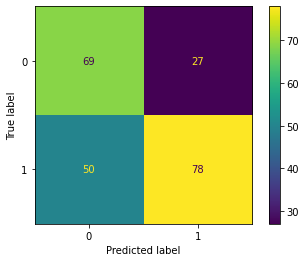

Runtime:  0  seconds


In [ ]:
#Train baseline Logit model
#Source: https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html
from sklearn.linear_model import LogisticRegression

start = dt.now()

#Selecting and Preparing data
target = y_train_b
features = X_train_b
test_features = X_test_b

#Preloading model#!
logit_b_baseline = LogisticRegression(C=0.24929450713871873, random_state=0)

#Robustness check with k-fold cross-validation#!

kfold = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
kfold_results = cross_val_score(logit_b_baseline, features, target, cv=kfold, scoring="f1_weighted")

#Fitting the final model on joined training and validation data#!
logit_b_baseline.fit(features, target)

#Predicting the train data
y_pred_tr = logit_b_baseline.predict(features)

#Predicting the test data
y_pred_te = logit_b_baseline.predict(test_features)

#Checking fscore
print("skfold validation f1-score mean: %.2f%% -||- sd: (%.2f%%)" % (kfold_results.mean()*100, kfold_results.std()*100))#!

print("train f1-score logit: ", f1_score(target, y_pred_tr, average='weighted'))#!

print("test f1-score logit: ", f1_score(y_test_b, y_pred_te, average='weighted'))

plot_confusion_matrix(logit_b_baseline, test_features, y_test_b)#!
plt.show()#!

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

In [54]:
##Logit validation f1-score confidence interval

x = 0.6120
sd = 0.0203
TP = 78
TN = 69
FP = 27
FN = 50

print("confidence interval of cross-validation weighted f1-score: ", x," +/- ",1.959 * sd / np.sqrt(5))

print("accuracy: ", (TP+TN)/(TP+FP+FN+TN))
print("recall: ", TP/(TP+FN))
print("precision: ", TP/(TP+FP))

confidence interval of cross-validation weighted f1-score:  0.612  +/-  0.017784656101763673
accuracy:  0.65625
recall:  0.609375
precision:  0.7428571428571429


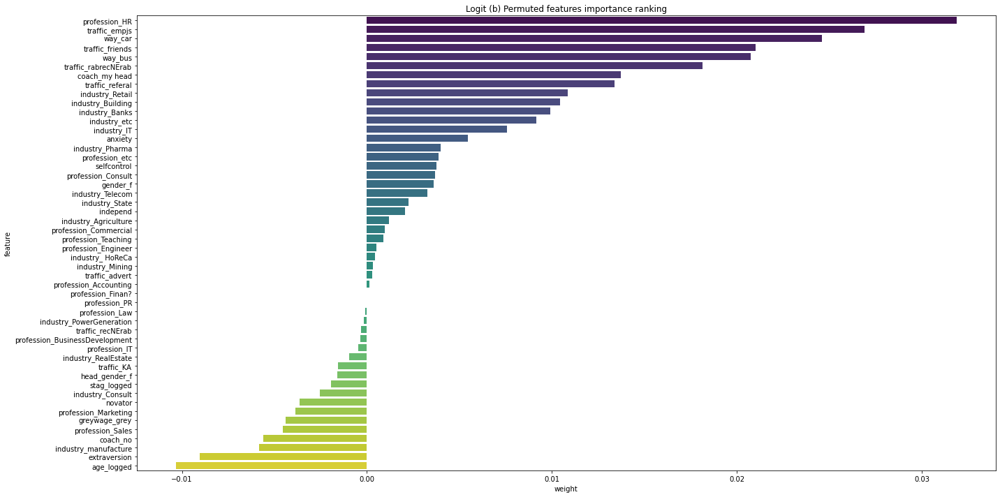

In [ ]:
###Checking permuted feature ranking

permuted_feature_ranking(logit_b_baseline, X_test_b, y_test_b, model_name="Logit (b)", standarscaler_object=None)

In [ ]:
###Partial dependence profiles
#Source: https://ema.drwhy.ai/partialDependenceProfiles.html

b_logit_exp = dx.Explainer(logit_b_baseline, X_test_b, y_test_b, label = "Babushkin Logit Pipeline")

pd_logit_n = b_logit_exp.model_profile(variables=[x for x in list(X_test_b.columns)], N=100)

ld_logit_n = b_logit_exp.model_profile(type="conditional", N=100)
ld_logit_n.result['_label_'] = 'LD profiles'
al_logit_n = b_logit_exp.model_profile(type="accumulated", N=100)
al_logit_n.result['_label_'] = 'AL profiles'
pd_logit_n.plot(al_logit_n.plot(ld_logit_n, variables=[x for x in list(X_test_b.columns)]))

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but LogisticRegression was fitted with feature names



Preparation of a new explainer is initiated

  -> data              : 224 rows 50 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 224 values
  -> model_class       : sklearn.linear_model._logistic.LogisticRegression (default)
  -> label             : Babushkin Logit Pipeline
  -> predict function  : <function yhat_proba_default at 0x7f6f45607c20> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 0.113, mean = 0.487, max = 0.811
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.811, mean = 0.0843, max = 0.755
  -> model_info        : package sklearn

A new explainer has been created!


Calculating accumulated dependency: 100%|██████████| 50/50 [00:04<00:00, 10.79it/s]


In [ ]:
###TUNING LIGHTGBM
#Source of general work-flow: https://github.com/optuna/optuna-examples/blob/main/lightgbm/lightgbm_simple.py; https://www.kaggle.com/code/code1110/dsb19-lgb-hyperparameter-tuning-optuna/notebook; https://medium.com/analytics-vidhya/hyperparameters-optimization-for-lightgbm-catboost-and-xgboost-regressors-using-bayesian-6e7c495947a9; https://medium.com/@pushkarmandot/https-medium-com-pushkarmandot-what-is-lightgbm-how-to-implement-it-how-to-fine-tune-the-parameters-60347819b7fc 
#Source of hyperparameter tunnning:  https://lightgbm.readthedocs.io/en/latest/Parameters-Tuning.html; https://ieeexplore-ieee-org.tilburguniversity.idm.oclc.org/abstract/document/9599143; https://link-springer-com.tilburguniversity.idm.oclc.org/article/10.1007/s10462-020-09896-5/tables/2
import lightgbm as lgbm

start = dt.now()

def m_f1_score(y_hat, data):
    y_true = data.get_label()
    y_hat = np.round(y_hat)
    return 'f1', f1_score(y_true, y_hat, average='weighted'), True

def Objective(trial):

    param = {
        'is_unbalance': True,#!
        'boosting_type': trial.suggest_categorical('boosting_type',['gbdt','dart']),#!
        'n_estimators': trial.suggest_int('n_estimators', 100, 2000, step=100),#!
        'num_leaves': trial.suggest_int('num_leaves', 10, 150, step=10),#!
        'learning_rate': trial.suggest_float("learning_rate", 0.005, 0.5, step=0.005),#!
        'verbose': -1,
        'seed': 0
        }

    kf = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
    CV_score_array =[]

    X_train = X_train_b
    y_train = y_train_b

    for train_index, valid_index in kf.split(X_train, y_train):
        evals_result = {}
        train_ix, valid_ix = X_train.values[train_index], X_train.values[valid_index]
        train_iy, valid_iy = y_train.values[train_index], y_train.values[valid_index]
        dtrain = lgbm.Dataset(train_ix, label=train_iy)
        dvalid = lgbm.Dataset(valid_ix, label=valid_iy)
        lgbm.train(param, dtrain, valid_sets=dvalid, feval=m_f1_score, evals_result=evals_result, verbose_eval=False, num_boost_round=10000)
        print("evals_result", evals_result)
        CV_score_array.append(max(evals_result["valid_0"]["f1"]))

    avg = np.mean(CV_score_array)
    return avg

study = optuna.create_study(direction="maximize", study_name='Lightgbm b table optimization')
study.optimize(Objective, n_trials=100)

lgb_best_params_b = study.best_params
print("Best parameters: ", lgb_best_params_b)

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

# Best parameters:  {'boosting_type': 'dart', 'n_estimators': 1200, 'num_leaves': 100, 'learning_rate': 0.325}
# Runtime:  2868  seconds

skfold validation f1-score mean: 64.44% -||- sd: (3.12%)
train f1-score lightgbm:  1.0
test f1-score lightgbm:  0.6757708268388736


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.



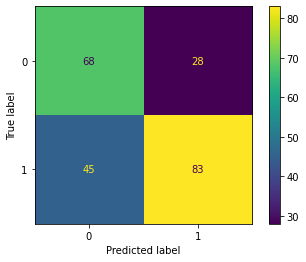

Runtime:  17  seconds


In [ ]:
###TRAINING LIGHTGBM
import lightgbm as lgbm

start = dt.now()

#Selecting and Preparing data
target = y_train_b
features = X_train_b
test_features = X_test_b

#Setting best fine tuned model -                        
lgbm_b = lgbm.LGBMClassifier(boosting_type = 'dart', #!
                          is_unbalance = True, #!
                          learning_rate = 0.325, #!
                          n_estimators = 1200,#!
                          num_leaves = 100,#!
                          seed=0)

#Robustness check with k-fold cross-validation#!

kfold = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
kfold_results = cross_val_score(lgbm_b, features, target, cv=kfold, scoring="f1_weighted")

#Fitting the final model on joined training and validation data
lgbm_b = lgbm_b.fit(features, target)

#Predicting the train data
y_pred_tr = lgbm_b.predict(features)

#Predicting the test data
y_pred_te = lgbm_b.predict(test_features)

#Checking fscore
print("skfold validation f1-score mean: %.2f%% -||- sd: (%.2f%%)" % (kfold_results.mean()*100, kfold_results.std()*100))

print("train f1-score lightgbm: ", f1_score(target, y_pred_tr, average='weighted'))

print("test f1-score lightgbm: ", f1_score(y_test_b, y_pred_te, average='weighted'))

plot_confusion_matrix(lgbm_b, test_features, y_test_b)
plt.show()

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

In [53]:
##Lightgbm validation f1-score confidence interval

x = 0.6444
sd = 0.0312
TP = 83
TN = 68
FP = 28
FN = 45

print("confidence interval of cross-validation weighted f1-score: ", x," +/- ",1.959 * sd / np.sqrt(5))

print("accuracy: ", (TP+TN)/(TP+FP+FN+TN))
print("recall: ", TP/(TP+FN))
print("precision: ", TP/(TP+FP))

confidence interval of cross-validation weighted f1-score:  0.6444  +/-  0.02733405272783383
accuracy:  0.6741071428571429
recall:  0.6484375
precision:  0.7477477477477478


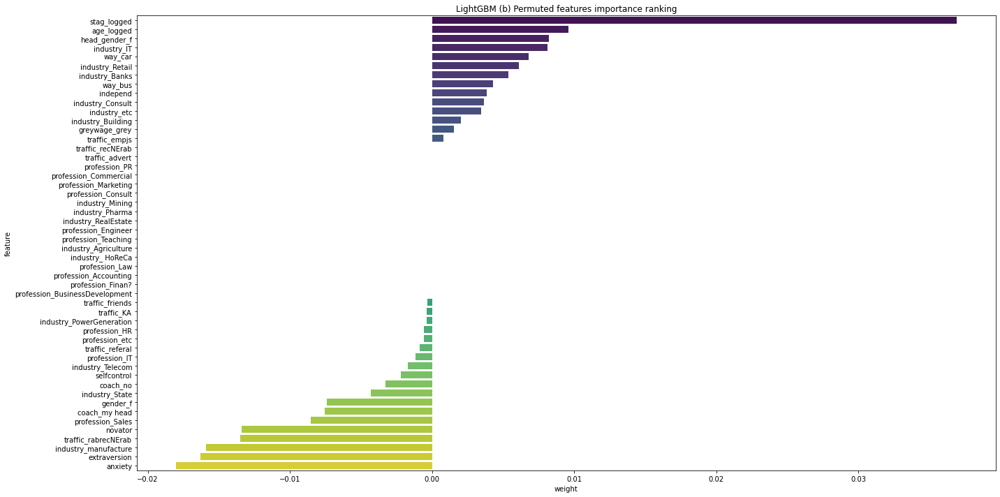

In [ ]:
###Checking permuted feature ranking

permuted_feature_ranking(lgbm_b, X_test_b, y_test_b, model_name="LightGBM (b)", standarscaler_object=None)

In [ ]:
###Partial dependence profiles
#Source: https://ema.drwhy.ai/partialDependenceProfiles.html

b_lightgbm_exp = dx.Explainer(lgbm_b, X_test_b, y_test_b, label = "Babushkin Lightgbm Pipeline")

pd_lgbm_n = b_lightgbm_exp.model_profile(variables=[x for x in list(X_test_b.columns)], N=100)

ld_lgbm_n = b_lightgbm_exp.model_profile(type="conditional", N=100)
ld_lgbm_n.result['_label_'] = 'LD profiles'
al_lgbm_n = b_lightgbm_exp.model_profile(type="accumulated", N=100)
al_lgbm_n.result['_label_'] = 'AL profiles'
pd_lgbm_n.plot(al_lgbm_n.plot(ld_lgbm_n, variables=[x for x in list(X_test_b.columns)]))

Preparation of a new explainer is initiated

  -> data              : 224 rows 50 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 224 values
  -> model_class       : lightgbm.sklearn.LGBMClassifier (default)
  -> label             : Babushkin Lightgbm Pipeline
  -> predict function  : <function yhat_proba_default at 0x7f6f45607c20> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 1.22e-07, mean = 0.508, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -1.0, mean = 0.0635, max = 1.0
  -> model_info        : package lightgbm

A new explainer has been created!


Calculating accumulated dependency: 100%|██████████| 50/50 [00:04<00:00, 10.97it/s]


In [ ]:
###TUNING RANDOM FOREST
#Source of general work-flow: https://www.analyticsvidhya.com/blog/2020/03/beginners-guide-random-forest-hyperparameter-tuning/; https://github.com/kathrinse/TabSurvey/blob/main/config/best_params.yml; https://towardsdatascience.com/hyperparameter-tuning-the-random-forest-in-python-using-scikit-learn-28d2aa77dd74; https://linuxtut.com/en/3bdae8c1098ced2dea5f/; https://github.com/optuna/optuna-examples/blob/main/xgboost/xgboost_cv.py
#Source for hyperparameter tunning: https://link-springer-com.tilburguniversity.idm.oclc.org/article/10.1007/s10462-020-09896-5/tables/2; https://wires.onlinelibrary.wiley.com/doi/full/10.1002/widm.1301?casa_token=vB15q2JbhxQAAAAA%3A34wJ3TkptdTTS7raRyDZDbK23zicE7b39SSCnMMWo4-xjwqsi8_LIeqi88_R3tTROUyqsOQCSFal3w; https://scikit-learn.org/stable/modules/ensemble.html#parameters; https://www.analyticsvidhya.com/blog/2015/06/tuning-random-forest-model/
from sklearn.ensemble import RandomForestClassifier

start = dt.now()

def Objective(trial):

    param = {
        'n_estimators': trial.suggest_int('n_estimators', 100, 2000, step=100), #!
        'max_features': trial.suggest_float('max_features', 0.25, 1.0, step=0.05), #!
        'class_weight': 'balanced_subsample',
        'criterion': 'entropy',
        'random_state': 0,
        'verbose': -1,
        }


    rf_b = RandomForestClassifier()
    
    kfold = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
    score = cross_val_score(rf_b, X_train_b, y=y_train_b, cv=kfold, scoring="f1_weighted", verbose = 0)
    f1_score_mean = score.mean()

    return f1_score_mean

study = optuna.create_study(direction="maximize", study_name='Random forest b table optimization')
study.optimize(Objective, n_trials=100)

rfc_best_params_b = study.best_params
print("Best parameters: ", rfc_best_params_b)

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

# Best parameters:  {'n_estimators': 1600, 'max_features': 0.9500000000000001}
# Runtime:  119  seconds

skfold validation f1-score mean: 63.58% -||- sd: (3.05%)
train f1-score random forest:  1.0
test f1-score random forest:  0.7155506491415693


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.



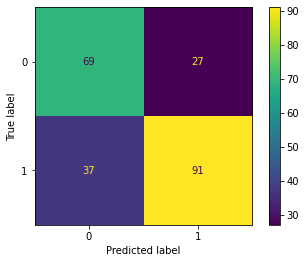

Runtime:  64  seconds


In [ ]:
###TRAINING RANDOM FOREST
from sklearn.ensemble import RandomForestClassifier

start = dt.now()

#Selecting and Preparing data
target = y_train_b
features = X_train_b
test_features = X_test_b

#Preloading model
rfc_b=RandomForestClassifier(
                             class_weight="balanced_subsample", 
                             criterion="entropy", 
                              max_features=0.9500000000000001, #!
                              n_estimators=1600, #!
                             random_state=0
                             )

#Robustness check with k-fold cross-validation
kfold = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
kfold_results = cross_val_score(rfc_b, features, target, cv=kfold, scoring="f1_weighted")

#Fitting the final model on joined training and validation data
rfc_b.fit(features, target)

#Predicting the train data
y_pred_tr = rfc_b.predict(features)

#Predicting the test data
y_pred_te = rfc_b.predict((test_features))

#Checking fscore
print("skfold validation f1-score mean: %.2f%% -||- sd: (%.2f%%)" % (kfold_results.mean()*100, kfold_results.std()*100))#!

print("train f1-score random forest: ", f1_score(target, y_pred_tr, average='weighted'))


print("test f1-score random forest: ", f1_score(y_test_b, y_pred_te, average='weighted'))

plot_confusion_matrix(rfc_b, test_features, y_test_b)
plt.show()

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

In [52]:
##Random forest validation f1-score confidence interval

x = 0.6358
sd = 0.0305
TP = 91
TN = 69
FP = 27
FN = 37

print("confidence interval of cross-validation weighted f1-score: ", x," +/- ",1.959 * sd / np.sqrt(5))

print("accuracy: ", (TP+TN)/(TP+FP+FN+TN))
print("recall: ", TP/(TP+FN))
print("precision: ", TP/(TP+FP))

confidence interval of cross-validation weighted f1-score:  0.6358  +/-  0.026720788724324738
accuracy:  0.7142857142857143
recall:  0.7109375
precision:  0.7711864406779662


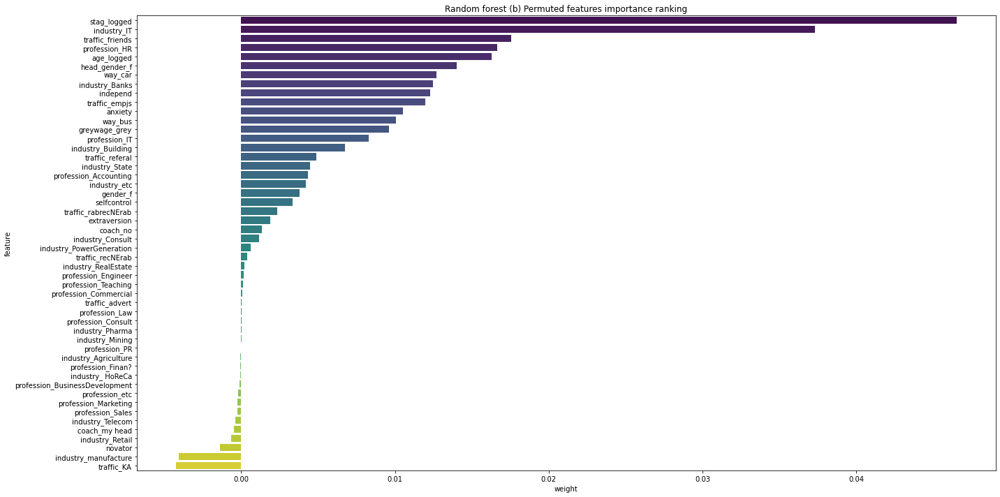

In [ ]:
###Checking permuted feature ranking

permuted_feature_ranking(rfc_b, X_test_b, y_test_b, model_name="Random forest (b)", standarscaler_object=None)

In [ ]:
###Partial dependence profiles
#Source: https://ema.drwhy.ai/partialDependenceProfiles.html

b_rfc_exp = dx.Explainer(rfc_b, X_test_b, y_test_b, label = "Babushkin Randomforest Pipeline")

pd_rfc_n = b_rfc_exp.model_profile(variables=[x for x in list(X_test_b.columns)], N=100)


ld_rfc_n = b_rfc_exp.model_profile(type="conditional", N=100)
ld_rfc_n.result['_label_'] = 'LD profiles'
al_rfc_n = b_rfc_exp.model_profile(type="accumulated", N=100)
al_rfc_n.result['_label_'] = 'AL profiles'
pd_rfc_n.plot(al_rfc_n.plot(ld_rfc_n, variables=[x for x in list(X_test_b.columns)]))

Preparation of a new explainer is initiated

  -> data              : 224 rows 50 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 224 values
  -> model_class       : sklearn.ensemble._forest.RandomForestClassifier (default)
  -> label             : Babushkin Randomforest Pipeline
  -> predict function  : <function yhat_proba_default at 0x7f6f45607c20> will be used (default)


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but RandomForestClassifier was fitted with feature names



  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 0.0219, mean = 0.511, max = 0.999
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.831, mean = 0.0602, max = 0.851
  -> model_info        : package sklearn

A new explainer has been created!


Calculating accumulated dependency: 100%|██████████| 50/50 [00:04<00:00, 11.46it/s]


In [ ]:
###TUNING XGBOOST
#Source: https://ieeexplore-ieee-org.tilburguniversity.idm.oclc.org/abstract/document/9160152; https://link-springer-com.tilburguniversity.idm.oclc.org/article/10.1007/s10462-020-09896-5/tables/2; https://github.com/optuna/optuna-examples/blob/main/xgboost/xgboost_cv.py 
import xgboost as xgb

start = dt.now()

def m_f1_score(y_hat, data):
    y_true = data.get_label()
    y_hat = np.round(y_hat)
    return 'f1', f1_score(y_true, y_hat, average='weighted')


def objective(trial):
    (data, target) = X_train_b, y_train_b
    dtrain = xgb.DMatrix(data, label=target)

    param = {
        "verbosity": 0,
        "objective": "binary:logistic",
        "n_estimators": trial.suggest_int("n_estimators", 200, 2000, step=10), #!
        "max_depth": trial.suggest_int("max_depth", 2, 110, step=5),#!
        "criterion": "entropy",
        "class_weight": "balanced_subsample",
        "subsample": trial.suggest_float("subsample", 0.1, 1.0, step=0.1),#!
        "colsample_bylevel": trial.suggest_float("colsample_bylevel", 0.25, 1.0, step=0.05), #!
        "gamma": trial.suggest_float("gamma", 0.0, 2.0, step=0.1), #!
        "learning_rate": trial.suggest_float("learning_rate", 0.005, 0.3, step=0.005), #!
        "random_state": 0,
    }


    xgb_cv_results_b = xgb.cv(
        params=param,
        dtrain=dtrain,
        num_boost_round=10000,
        nfold=5,
        stratified=True,
        early_stopping_rounds=100,
        seed=0,
        verbose_eval=False,
        feval=m_f1_score,
    )

    best_score = xgb_cv_results_b["test-f1-mean"].values[-1]
    return best_score

if __name__ == "__main__":

    study = optuna.create_study(direction="maximize", study_name='Xgboost b table optimization')
    study.optimize(objective, n_trials=100)

    xgb_best_params_b = study.best_params
    print("Best parameters: ", xgb_best_params_b)

    running_secs = (dt.now() - start).seconds
    print("Runtime: ", running_secs, " seconds")

# Best parameters:  {'n_estimators': 1950, 'max_depth': 57, 'subsample': 1.0, 'colsample_bylevel': 0.5, 'gamma': 1.4000000000000001, 'learning_rate': 0.11}
# Runtime:  282  seconds

skfold validation f1-score mean: 62.63% -||- sd: (3.37%)
train f1-score xgboost:  1.0
test f1-score xgboost:  0.7023759338122482


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.



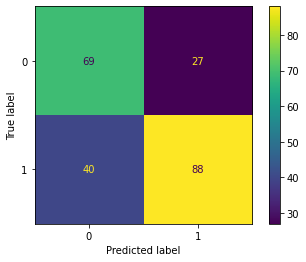

Runtime:  28  seconds


In [ ]:
###TRANING XGBOOST
import xgboost as xgb

start = dt.now()

#Selecting and Preparing data
target = y_train_b
features = X_train_b
test_features = X_test_b

#Preloading model
xgb_b = xgb.XGBClassifier(seed=0,
                           random_state=0,
                           objective='binary:logistic',
                           n_estimators=1950, #!
                           max_depth=57, #!
                           eta=0.85, #!
                           criterion='entropy',
                           subsample= 1.0, #!
                           class_weight= "balanced_subsample",
                           colsample_bylevel=0.5,#!
                           gamma=1.4000000000000001,#!
                           learning_rate=0.11,#!
                           )

#Robustness check with k-fold cross-validation
kfold = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
kfold_results = cross_val_score(xgb_b, features, target, cv=kfold, scoring="f1_weighted")

#Fitting the final model on joined training and validation data
xgb_b.fit(features, target)

#Predicting the train data
y_pred_tr = xgb_b.predict(features)

#Predicting the test data
y_pred_te = xgb_b.predict(test_features)

#Checking fscore
print("skfold validation f1-score mean: %.2f%% -||- sd: (%.2f%%)" % (kfold_results.mean()*100, kfold_results.std()*100))

print("train f1-score xgboost: ", f1_score(target, y_pred_tr, average='weighted'))

print("test f1-score xgboost: ", f1_score(y_test_b, y_pred_te, average='weighted'))

plot_confusion_matrix(xgb_b, test_features, y_test_b)
plt.show()

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

In [51]:
##Xgboost validation f1-score confidence interval

x = 0.6263
sd = 0.0337
TP = 88
TN = 69
FP = 27
FN = 40

print("confidence interval of cross-validation weighted f1-score: ", x," +/- ",1.959 * sd / np.sqrt(5))

print("accuracy: ", (TP+TN)/(TP+FP+FN+TN))
print("recall: ", TP/(TP+FN))
print("precision: ", TP/(TP+FP))

confidence interval of cross-validation weighted f1-score:  0.6263  +/-  0.029524281311794874
accuracy:  0.7008928571428571
recall:  0.6875
precision:  0.7652173913043478


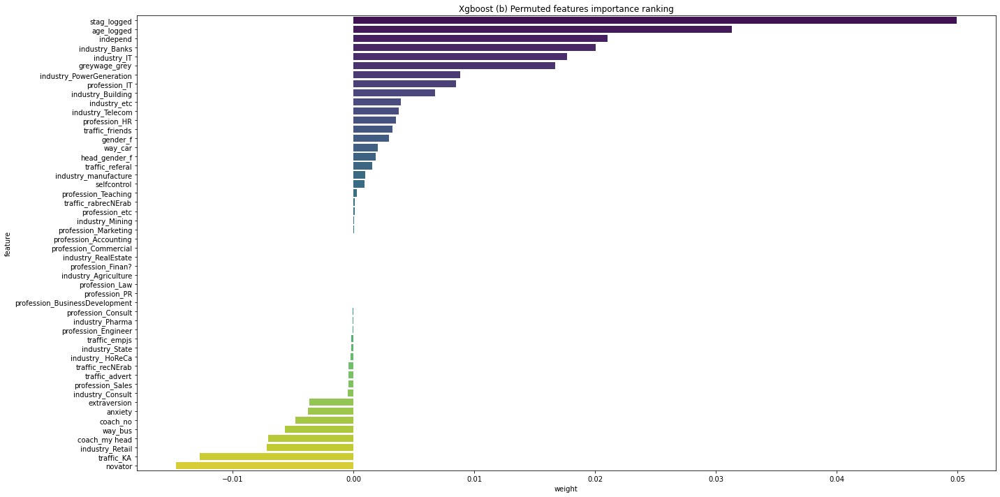

In [ ]:
###Checking permuted feature ranking

permuted_feature_ranking(xgb_b, X_test_b, y_test_b, model_name="Xgboost (b)", standarscaler_object=None)

In [ ]:
###Partial dependence profiles
#Source: https://ema.drwhy.ai/partialDependenceProfiles.html

b_xgb_exp = dx.Explainer(xgb_b, X_test_b, y_test_b, label = "Babushkin Xgboost Pipeline")

pd_xgb_n = b_xgb_exp.model_profile(variables=[x for x in list(X_test_b.columns)], N=100)


ld_xgb_n = b_xgb_exp.model_profile(type="conditional", N=100)
ld_xgb_n.result['_label_'] = 'LD profiles'
al_xgb_n = b_xgb_exp.model_profile(type="accumulated", N=100)
al_xgb_n.result['_label_'] = 'AL profiles'
pd_xgb_n.plot(al_xgb_n.plot(ld_xgb_n, variables=[x for x in list(X_test_b.columns)]))

Preparation of a new explainer is initiated

  -> data              : 224 rows 50 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 224 values
  -> model_class       : xgboost.sklearn.XGBClassifier (default)
  -> label             : Babushkin Xgboost Pipeline
  -> predict function  : <function yhat_proba_default at 0x7f6f45607c20> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.0152, mean = 0.498, max = 0.982
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.959, mean = 0.0732, max = 0.966
  -> model_info        : package xgboost

A new explainer has been created!


Calculating accumulated dependency: 100%|██████████| 50/50 [00:04<00:00, 10.96it/s]


In [ ]:
###Installing libraries

#Importing libraries and setting seed
np.random.seed(0)

In [ ]:
###TUNING TABNET
#Source of general work-flow: https://www.kaggle.com/code/neilgibbons/tuning-tabnet-with-optuna; https://github.com/dreamquark-ai/tabnet; https://optuna.readthedocs.io/en/stable/reference/generated/optuna.samplers.RandomSampler.html?highlight=random%20gridsearch; https://deepai.org/publication/tabnet-attentive-interpretable-tabular-learning
#Source fast training: https://github.com/dreamquark-ai/tabnet/issues/97
from pytorch_tabnet.tab_model import TabNetClassifier

start = dt.now()

TabNet_params = []

class F1_score(Metric):
    def __init__(self):
        self._name = "f1_score"
        self._maximize = True

    def __call__(self, y_true, y_score):
        y_score = np.where(y_score > 0.5, 1, 0)
        y_score = y_score[:,1]
        return f1_score(y_true, y_score, average="weighted")

def Objective(trial):
    mask_type = "entmax"
    n_d = trial.suggest_int("n_d", 32, 48, step=1) #!
    n_steps = trial.suggest_int("n_steps", 2, 3, step=1) #!
    gamma = trial.suggest_float("gamma", 1.0, 2.0, step=0.2) #!
    n_independent = trial.suggest_int("n_independent", 1, 4, step=1)
    n_shared = trial.suggest_int("n_shared", 1, 2, step=1)
    lambda_sparse = trial.suggest_float("lambda_sparse", 1e-6, 1e-2, log=True)
    optimizer_fn = trial.suggest_categorical("optimizer_fn", [torch.optim.Adadelta, torch.optim.Adagrad, torch.optim.Adam, torch.optim.Adamax, torch.optim.RMSprop, torch.optim.SGD])

    tabnet_params = dict(n_d=n_d, n_a=n_d, n_steps=n_steps, gamma=gamma, n_independent=n_independent,
                     lambda_sparse=lambda_sparse, optimizer_fn=optimizer_fn,
                     optimizer_params=dict(lr=2e-2, weight_decay=1e-5),#!
                     mask_type=mask_type, n_shared=n_shared,
                     scheduler_params=dict(mode="min", 
                                           patience = 5,
                                           min_lr=1e-5,#!
                                           factor=0.5),
                     scheduler_fn=torch.optim.lr_scheduler.ReduceLROnPlateau,
                     verbose=0,
                     seed=0,
                     )
    
    kf = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
    CV_score_array =[]
    X_train = X_train_b
    y_train = y_train_b

    for train_index, valid_index in kf.split(X_train.values, y_train.values):
        X_train_ix, X_valid_ix = X_train.values[train_index], X_train.values[valid_index]
        y_train_ix, y_valid_ix = y_train.values[train_index], y_train.values[valid_index]

        sc = StandardScaler()
        X_train_ix = sc.fit_transform(X_train_ix)
        X_valid_ix = sc.transform(X_valid_ix)

        classifier = TabNetClassifier(**tabnet_params)
        classifier.fit(X_train=X_train_ix, y_train=y_train_ix,
                  eval_set=[(X_train_ix, y_train_ix), (X_valid_ix, y_valid_ix)],
                  patience=10, max_epochs=50,
                  eval_metric=[F1_score], batch_size=32, virtual_batch_size=32)#!
        CV_score_array.append(classifier.best_cost)

    avg = np.mean(CV_score_array)
    return avg

study = optuna.create_study(direction="maximize", study_name='TabNet b table optimization')
study.optimize(Objective, n_trials=100)

tabnet_params_b = study.best_params
print("Best parameters: ", tabnet_params_b)

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

# Best parameters:  {'n_d': 40, 'n_steps': 3, 'gamma': 1.0, 'n_independent': 1, 'n_shared': 1, 'lambda_sparse': 2.4216038361156447e-06, 'optimizer_fn': <class 'torch.optim.adam.Adam'>}
# Runtime:  10935  seconds


Early stopping occurred at epoch 41 with best_epoch = 31 and best_val_1_f1_score = 0.67476
Best weights from best epoch are automatically used!

Early stopping occurred at epoch 17 with best_epoch = 7 and best_val_1_f1_score = 0.71379
Best weights from best epoch are automatically used!

Early stopping occurred at epoch 10 with best_epoch = 0 and best_val_1_f1_score = 0.775
Best weights from best epoch are automatically used!

Early stopping occurred at epoch 10 with best_epoch = 0 and best_val_1_f1_score = 0.77983
Best weights from best epoch are automatically used!

Early stopping occurred at epoch 24 with best_epoch = 14 and best_val_1_f1_score = 0.70798
Best weights from best epoch are automatically used!

Early stopping occurred at epoch 11 with best_epoch = 1 and best_valid_f1_score = 0.88259
Best weights from best epoch are automatically used!


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:444: UserWarning:

X has feature names, but StandardScaler was fitted without feature names

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:444: UserWarning:

X has feature names, but StandardScaler was fitted without feature names



skfold validation f1-score mean: 73.03% -||- sd: (4.08%)
train f1_score of tabnet:  0.9260153013215998
test f1_score of tabnet:  0.6617835497835498
Runtime:  87  seconds


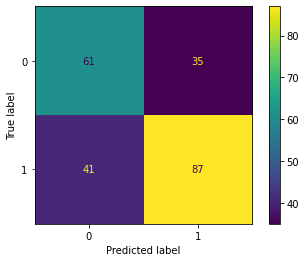

In [ ]:
###TRAINING TABNET
#Source: https://github.com/dreamquark-ai/tabnet, https://www.stackvidhya.com/plot-confusion-matrix-in-python-and-why/
from pytorch_tabnet.tab_model import TabNetClassifier

start = dt.now()

class F1_score(Metric):
    def __init__(self):
        self._name = "f1_score"
        self._maximize = True

    def __call__(self, y_true, y_score):
        y_score = np.where(y_score > 0.5, 1, 0)
        y_score = y_score[:,1]
        return f1_score(y_true, y_score, average="weighted")

#Selecting and Preparing data
X_train = X_train_b
y_train = y_train_b

n_total_train = len(X_train)

train_indices, valid_indices = train_test_split(range(n_total_train), test_size=0.2, random_state=0)

#Preloading model
tb_b = TabNetClassifier(
    n_d=40,
    n_a=40,
    n_steps=3,
    gamma=1.0,
    n_independent=1,
    n_shared=1,
    lambda_sparse=2.4216038361156447e-06,
    optimizer_fn=torch.optim.Adam,
    optimizer_params=dict(lr=2e-2, weight_decay=1e-5),
    scheduler_params = dict(mode="min",
                            patience=5,
                            min_lr=1e-5,
                            factor=0.5),
    scheduler_fn=torch.optim.lr_scheduler.ReduceLROnPlateau,
    mask_type='entmax',
    seed=0,
    verbose=0
)

X_train_tb = X_train.values[train_indices] 
y_train_tb = y_train.values[train_indices]

X_valid_tb = X_train.values[valid_indices]
y_valid_tb = y_train.values[valid_indices]

sc_1 = StandardScaler()
X_train_tb = sc_1.fit_transform(X_train_tb)
X_valid_tb = sc_1.transform(X_valid_tb)

#Robustness check with k-fold cross-validation#!

kf = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
CV_score_array =[]

for train_index, valid_index in kf.split(X_train.values, y_train.values):
    X_train_ix, X_valid_ix = X_train.values[train_index], X_train.values[valid_index]
    y_train_ix, y_valid_ix = y_train.values[train_index], y_train.values[valid_index]

    sc = StandardScaler()
    X_train_ix = sc.fit_transform(X_train_ix)
    X_valid_ix = sc.transform(X_valid_ix)

    tb_b.fit(X_train=X_train_ix, y_train=y_train_ix,
              eval_set=[(X_train_ix, y_train_ix), (X_valid_ix, y_valid_ix)],
              patience=10, max_epochs=50,
              eval_metric=[F1_score], batch_size=32, virtual_batch_size=32)
    CV_score_array.append(tb_b.best_cost)

avg = np.mean(CV_score_array)
sd = np.std(CV_score_array)

#Fitting the final model on joined training and validation data

max_epochs = 50

tb_b.fit(
    X_train=X_train_tb, y_train=y_train_tb,
    eval_set=[(X_train_tb, y_train_tb), (X_valid_tb, y_valid_tb)],
    eval_name=['train', 'valid'],
    eval_metric=[F1_score],
    max_epochs=max_epochs,
    patience=10,
    batch_size=32, virtual_batch_size=32
)

preds_mapper = { idx : class_name for idx, class_name in enumerate(tb_b.classes_)}

#Predicting the train data
preds_b_tr = tb_b.predict(sc_1.transform(X_train_b))

#Predicting the test data
preds_b_te = tb_b.predict(sc_1.transform(X_test_b))

print("skfold validation f1-score mean: %.2f%% -||- sd: (%.2f%%)" % (avg*100, sd*100))#!

print("train f1_score of tabnet: ",f1_score(y_pred=preds_b_tr, y_true=y_train_b, average='weighted'))

print("test f1_score of tabnet: ",f1_score(y_pred=preds_b_te, y_true=y_test_b, average='weighted'))

cf_matrix = confusion_matrix(y_test_b, preds_b_te)
disp = ConfusionMatrixDisplay(confusion_matrix=cf_matrix)
disp.plot()


running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

In [49]:
##TABNET validation f1-score confidence interval

x = 0.7303
sd = 0.0408
TP = 87
TN = 61
FP = 35
FN = 41

print("confidence interval of cross-validation weighted f1-score: ", x," +/- ",1.959 * sd / np.sqrt(5))

print("accuracy: ", (TP+TN)/(TP+FP+FN+TN))
print("recall: ", TP/(TP+FN))
print("precision: ", TP/(TP+FP))

confidence interval of cross-validation weighted f1-score:  0.7303  +/-  0.03574453049024424
accuracy:  0.6607142857142857
recall:  0.6796875
precision:  0.7131147540983607


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:444: UserWarning:

X has feature names, but StandardScaler was fitted without feature names



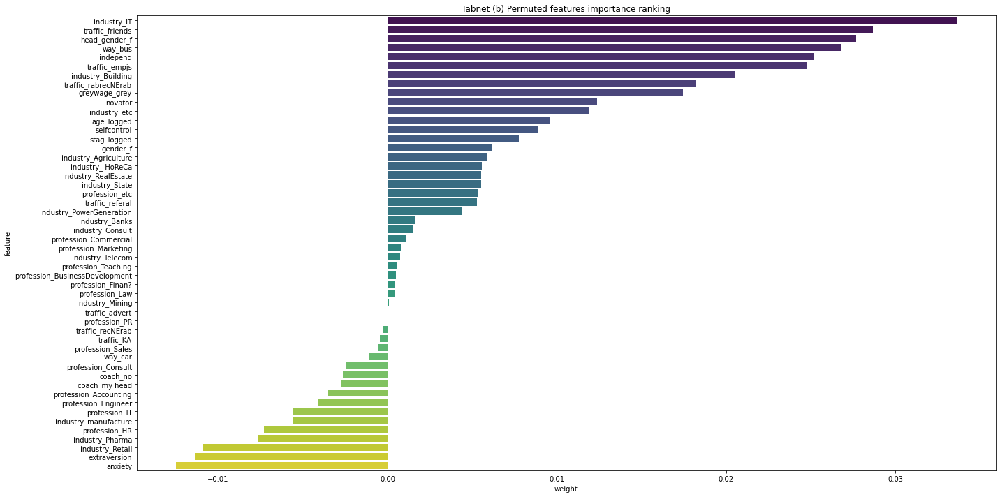

In [ ]:
###Checking permuted feature ranking

permuted_feature_ranking(tb_b, X_test_b, y_test_b, model_name="Tabnet (b)", standarscaler_object=sc_1)

In [ ]:
###Generate Feature importance heatmap
#Source: https://www.kaggle.com/code/mmkuznecov/tabnet-catboost-flaml

#Extracting the explainability parameters
explainability_matrix , masks = tb_b.explain(sc_1.transform(X_test_b))

#Normalize the importance by sample
normalized_explain_mat = np.divide(explainability_matrix, explainability_matrix.sum(axis=1).reshape(-1, 1)+1e-8)

#Add prediction to better understand correlation between features and predictions
val_preds = tb_b.predict(sc_1.transform(X_test_b))

explain_and_preds = np.hstack([normalized_explain_mat, val_preds.reshape(-1, 1)])

features = [i for i in list(X_test_b.columns)]

px.imshow(explain_and_preds[:,:],
          labels=dict(x="Features", y="Samples", color="Importance"),
          x=features+["prediction"],
          title="Sample wise feature importance",
          color_continuous_scale='viridis',
          height=1000)

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:444: UserWarning:

X has feature names, but StandardScaler was fitted without feature names

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:444: UserWarning:

X has feature names, but StandardScaler was fitted without feature names



#IBM HRA dt

In [ ]:
###Separating differently encoded variables

float_features_i = ibmhdt_df.loc[:, ["Age","DailyRate","DistanceFromHome","Education","EnvironmentSatisfaction","HourlyRate","JobInvolvement","JobLevel","JobSatisfaction","MonthlyIncome","MonthlyRate","NumCompaniesWorked","PercentSalaryHike","RelationshipSatisfaction","StockOptionLevel","TotalWorkingYears","TrainingTimesLastYear","WorkLifeBalance","YearsAtCompany","YearsInCurrentRole","YearsSinceLastPromotion","YearsWithCurrManager"]] #int
dummy_features_i = ibmhdt_df.loc[:, ["Gender","OverTime","PerformanceRating","Attrition","Department","EducationField","JobRole", "BusinessTravel","MaritalStatus"]] #dummy

In [ ]:
###Encoding features

dummy_features_i = pd.concat([pd.get_dummies(dummy_features_i['Gender'], prefix='Gender').iloc[:,0],
                              pd.get_dummies(dummy_features_i['OverTime'], prefix='OverTime').iloc[:,0],
                              pd.get_dummies(dummy_features_i['PerformanceRating'], prefix='PerformanceRating').iloc[:,0],
                              pd.get_dummies(dummy_features_i['Attrition'], prefix='Attrition').iloc[:,0],
                              pd.get_dummies(dummy_features_i['Department'], prefix='Department').iloc[:,0:2],
                              pd.get_dummies(dummy_features_i['EducationField'], prefix='EducationField').iloc[:,0:5],
                              pd.get_dummies(dummy_features_i['JobRole'], prefix='JobRole').iloc[:,0:8],
                              pd.get_dummies(dummy_features_i['BusinessTravel'], prefix='BusinessTravel').iloc[:,0:2],
                              pd.get_dummies(dummy_features_i['MaritalStatus'], prefix='MaritalStatus').iloc[:,0:2]], axis=1)

In [ ]:
###Concat all subdfs into 1

concated_df_i = pd.concat([float_features_i, dummy_features_i], axis=1)

In [ ]:
###Rename the variables
concated_df_i = concated_df_i.loc[:,['Age', 'DailyRate', 'DistanceFromHome', 'Education',
       'EnvironmentSatisfaction', 'HourlyRate', 'JobInvolvement', 'JobLevel',
       'JobSatisfaction', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'PercentSalaryHike', 'RelationshipSatisfaction', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager', 'Gender_Female', 'OverTime_No',
       'PerformanceRating_3', 'Department_Human Resources',
       'Department_Research & Development', 'EducationField_Human Resources',
       'EducationField_Life Sciences', 'EducationField_Marketing',
       'EducationField_Medical', 'EducationField_Other',
       'JobRole_Healthcare Representative', 'JobRole_Human Resources',
       'JobRole_Laboratory Technician', 'JobRole_Manager',
       'JobRole_Manufacturing Director', 'JobRole_Research Director',
       'JobRole_Research Scientist', 'JobRole_Sales Executive',
       'BusinessTravel_Non-Travel', 'BusinessTravel_Travel_Frequently',
       'MaritalStatus_Divorced', 'MaritalStatus_Married', 'Attrition_No']]

In [ ]:
###Log scaling not normal feature data distributions

concated_df_i.loc[:,["Age", "DailyRate", "DistanceFromHome", "Education", "HourlyRate", "JobInvolvement", "JobLevel", "JobSatisfaction", "MonthlyIncome", "MonthlyRate", "NumCompaniesWorked", "PercentSalaryHike", "RelationshipSatisfaction", "StockOptionLevel", "TotalWorkingYears", "WorkLifeBalance", "YearsAtCompany", "YearsInCurrentRole", "YearsSinceLastPromotion", "YearsWithCurrManager"]]+=1
concated_log_df_i = np.log(concated_df_i.loc[:,["Age", "DailyRate", "DistanceFromHome", "Education", "HourlyRate", "JobInvolvement", "JobLevel", "JobSatisfaction", "MonthlyIncome", "MonthlyRate", "NumCompaniesWorked", "PercentSalaryHike", "RelationshipSatisfaction", "StockOptionLevel", "TotalWorkingYears", "WorkLifeBalance", "YearsAtCompany", "YearsInCurrentRole", "YearsSinceLastPromotion", "YearsWithCurrManager"]])
concated_df_i = concated_df_i.drop(["Age", "DailyRate", "DistanceFromHome", "Education", "HourlyRate", "JobInvolvement", "JobLevel", "JobSatisfaction", "MonthlyIncome", "MonthlyRate", "NumCompaniesWorked", "PercentSalaryHike", "RelationshipSatisfaction", "StockOptionLevel", "TotalWorkingYears", "WorkLifeBalance", "YearsAtCompany", "YearsInCurrentRole", "YearsSinceLastPromotion", "YearsWithCurrManager"], axis = 1)


In [ ]:
###Splitting data

concated_df_i = pd.concat([concated_log_df_i, concated_df_i], axis=1)
X_i = concated_df_i.iloc[:,:-1]
y_i = concated_df_i.iloc[:,-1]

X_train_i, X_test_i, y_train_i, y_test_i = train_test_split(X_i, y_i, test_size=0.2, random_state=0)

In [ ]:
###Rename logged headers for graphs

for i in ["Age", "DailyRate", "DistanceFromHome", "Education", "HourlyRate", "JobInvolvement", "JobLevel", "JobSatisfaction", "MonthlyIncome", "MonthlyRate", "NumCompaniesWorked", "PercentSalaryHike", "RelationshipSatisfaction", "StockOptionLevel", "TotalWorkingYears", "WorkLifeBalance", "YearsAtCompany", "YearsInCurrentRole", "YearsSinceLastPromotion", "YearsWithCurrManager"]:
  X_test_i = X_test_i.rename(columns={f"{i}": f"{i}_logged"})
  X_train_i = X_train_i.rename(columns={f"{i}": f"{i}_logged"})

In [ ]:
#Hyperparameter tunning of baseline Logit model
from sklearn.linear_model import LogisticRegression

start = dt.now()

def m_f1_score(y_hat, data):
    y_true = data.get_label()
    y_hat = np.round(y_hat)
    return 'f1', f1_score(y_true, y_hat, average='weighted'), True

def Objective(trial):

    param = {
        'C' : trial.suggest_loguniform("C", 1e-2, 1),
        'random_state':0,
        'verbose':1
        }

    kf = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
    CV_score_array =[]

    X_train = X_train_i
    y_train = y_train_i

    for train_index, valid_index in kf.split(X_train, y_train):
        evals_result = []
        train_ix, valid_ix = X_train.values[train_index], X_train.values[valid_index]
        train_iy, valid_iy = y_train.values[train_index], y_train.values[valid_index]
        logit = LogisticRegression(**param)
        logit.fit(train_ix, train_iy)
        y_pred = logit.predict(valid_ix)
        evals_result = f1_score(valid_iy, y_pred, average='weighted')

        print("evals_result f1_score:", evals_result)
        CV_score_array.append(evals_result)

    avg = np.mean(CV_score_array)
    return avg

study = optuna.create_study(direction="maximize", study_name='Logit i table optimization')
study.optimize(Objective, n_trials=100)

logit_best_params_i = study.best_params
print("Best parameters: ", logit_best_params_i)

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

# Best parameters:  {'C': 0.4388125870414256}
# Runtime:  50  seconds

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/usr/local/lib/python3.7/dist-packages/sklearn/lin

skfold validation f1-score mean: 87.42% -||- sd: (1.41%)
train f1-score logit:  0.8735685924117087
test f1-score logit:  0.8663867355727821


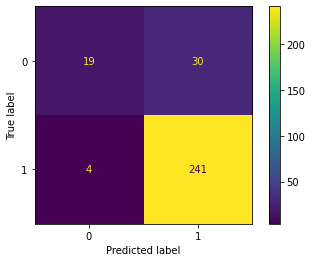

Runtime:  1  seconds


In [ ]:
#Train baseline Logit model
#Source: https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html
from sklearn.linear_model import LogisticRegression

start = dt.now()

#Selecting and Preparing data
target = y_train_i
features = X_train_i
test_features = X_test_i

#Preloading model#!
logit_i_baseline = LogisticRegression(C=0.4388125870414256, random_state=0)

#Robustness check with k-fold cross-validation#!

kfold = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
kfold_results = cross_val_score(logit_i_baseline, features, target, cv=kfold, scoring="f1_weighted")

#Fitting the final model on joined training and validation data#!
logit_i_baseline.fit(features, target)

#Predicting the train data
y_pred_tr = logit_i_baseline.predict(features)

#Predicting the test data
y_pred_te = logit_i_baseline.predict(test_features)

#Checking fscore
print("skfold validation f1-score mean: %.2f%% -||- sd: (%.2f%%)" % (kfold_results.mean()*100, kfold_results.std()*100))

print("train f1-score logit: ", f1_score(target, y_pred_tr, average='weighted'))

print("test f1-score logit: ", f1_score(y_test_i, y_pred_te, average='weighted'))

plot_confusion_matrix(logit_i_baseline, test_features, y_test_i)
plt.show()

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

In [48]:
##Logit validation f1-score confidence interval

x = 0.8742
sd = 0.0141
TP = 241
TN = 19
FP = 30
FN = 4

print("confidence interval of cross-validation weighted f1-score: ", x," +/- ",1.959 * sd / np.sqrt(5))

print("accuracy: ", (TP+TN)/(TP+FP+FN+TN))
print("recall: ", TP/(TP+FN))
print("precision: ", TP/(TP+FP))

confidence interval of cross-validation weighted f1-score:  0.8742  +/-  0.012352889213540288
accuracy:  0.8843537414965986
recall:  0.9836734693877551
precision:  0.8892988929889298


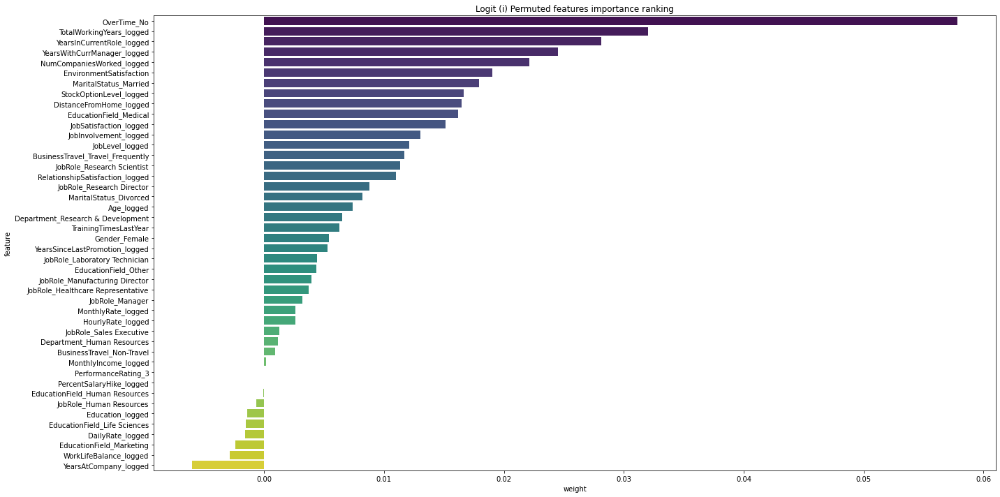

In [ ]:
###Checking permuted feature ranking

permuted_feature_ranking(logit_i_baseline, X_test_i, y_test_i, model_name="Logit (i)", standarscaler_object=None)

In [ ]:
###Partial dependence profiles
#Source: https://ema.drwhy.ai/partialDependenceProfiles.html

i_logit_exp = dx.Explainer(logit_i_baseline, X_test_i, y_test_i, label = "IBM Logit Pipeline")

pd_logit_n = i_logit_exp.model_profile(variables=[x for x in list(X_test_i.columns)], N=100)

ld_logit_n = i_logit_exp.model_profile(type="conditional", N=100)
ld_logit_n.result['_label_'] = 'LD profiles'
al_logit_n = i_logit_exp.model_profile(type="accumulated", N=100)
al_logit_n.result['_label_'] = 'AL profiles'
pd_logit_n.plot(al_logit_n.plot(ld_logit_n, variables=[x for x in list(X_test_i.columns)]))

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but LogisticRegression was fitted with feature names



Preparation of a new explainer is initiated

  -> data              : 294 rows 44 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 294 values
  -> model_class       : sklearn.linear_model._logistic.LogisticRegression (default)
  -> label             : IBM Logit Pipeline
  -> predict function  : <function yhat_proba_default at 0x7f6f45607c20> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 0.0738, mean = 0.836, max = 0.998
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.967, mean = -0.00256, max = 0.642
  -> model_info        : package sklearn

A new explainer has been created!


Calculating accumulated dependency: 100%|██████████| 44/44 [00:04<00:00, 10.81it/s]


In [ ]:
####Target models:

In [ ]:
###TUNING LIGHTGBM
#Source of general work-flow: https://github.com/optuna/optuna-examples/blob/main/lightgbm/lightgbm_simple.py; https://www.kaggle.com/code/code1110/dsb19-lgb-hyperparameter-tuning-optuna/notebook; https://medium.com/analytics-vidhya/hyperparameters-optimization-for-lightgbm-catboost-and-xgboost-regressors-using-bayesian-6e7c495947a9; https://medium.com/@pushkarmandot/https-medium-com-pushkarmandot-what-is-lightgbm-how-to-implement-it-how-to-fine-tune-the-parameters-60347819b7fc 
#Source of hyperparameter tunnning:  https://lightgbm.readthedocs.io/en/latest/Parameters-Tuning.html; https://ieeexplore-ieee-org.tilburguniversity.idm.oclc.org/abstract/document/9599143; https://link-springer-com.tilburguniversity.idm.oclc.org/article/10.1007/s10462-020-09896-5/tables/2
import lightgbm as lgbm

start = dt.now()

def m_f1_score(y_hat, data):
    y_true = data.get_label()
    y_hat = np.round(y_hat)
    return 'f1', f1_score(y_true, y_hat, average='weighted'), True

def Objective(trial):

    param = {
        'is_unbalance': True,#!
        'boosting_type': trial.suggest_categorical('boosting_type',['gbdt','dart']),#!
        'n_estimators': trial.suggest_int('n_estimators', 100, 2000, step=100),#!
        'num_leaves': trial.suggest_int('num_leaves', 10, 150, step=10),#!
        'learning_rate': trial.suggest_float("learning_rate", 0.005, 0.5, step=0.005),#!
        'verbose': -1,
        'seed': 0
        }

    kf = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
    CV_score_array =[]

    X_train = X_train_i
    y_train = y_train_i

    for train_index, valid_index in kf.split(X_train, y_train):
        evals_result = {}
        train_ix, valid_ix = X_train.values[train_index], X_train.values[valid_index]
        train_iy, valid_iy = y_train.values[train_index], y_train.values[valid_index]
        dtrain = lgbm.Dataset(train_ix, label=train_iy)
        dvalid = lgbm.Dataset(valid_ix, label=valid_iy)
        lgbm.train(param, dtrain, valid_sets=dvalid, feval=m_f1_score, evals_result=evals_result, verbose_eval=False, num_boost_round=10000)
        print("evals_result", evals_result)
        CV_score_array.append(max(evals_result["valid_0"]["f1"]))

    avg = np.mean(CV_score_array)
    return avg

study = optuna.create_study(direction="maximize", study_name='Lightgbm i table optimization')
study.optimize(Objective, n_trials=100)

lgb_best_params_i = study.best_params
print("Best parameters: ", lgb_best_params_i)

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

# Best parameters:  {'boosting_type': 'dart', 'n_estimators': 2000, 'num_leaves': 70, 'learning_rate': 0.29000000000000004}
# Runtime:  4956  seconds

skfold validation f1-score mean: 85.45% -||- sd: (1.33%)
train f1-score lightgbm:  1.0
test f1-score lightgbm:  0.8089706688596493


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.



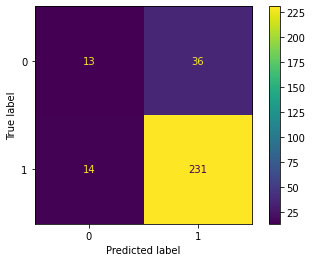

Runtime:  50  seconds


In [ ]:
###TRAINING LIGHTGBM
import lightgbm as lgbm

start = dt.now()

#Selecting and Preparing data
target = y_train_i
features = X_train_i
test_features = X_test_i

#Setting best fine tuned model -                        
lgbm_i = lgbm.LGBMClassifier(boosting_type = 'dart', #!
                          is_unbalance = True, #!
                          learning_rate = 0.29000000000000004, #!
                          n_estimators = 2000,#!
                          num_leaves = 70,#!
                          seed=0)

#Robustness check with k-fold cross-validation#!

kfold = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
kfold_results = cross_val_score(lgbm_i, features, target, cv=kfold, scoring="f1_weighted")

#Fitting the final model on joined training and validation data
lgbm_i = lgbm_i.fit(features, target)

#Predicting the train data
y_pred_tr = lgbm_i.predict(features)

#Predicting the test data
y_pred_te = lgbm_i.predict(test_features)

#Checking fscore
print("skfold validation f1-score mean: %.2f%% -||- sd: (%.2f%%)" % (kfold_results.mean()*100, kfold_results.std()*100))

print("train f1-score lightgbm: ", f1_score(target, y_pred_tr, average='weighted'))

print("test f1-score lightgbm: ", f1_score(y_test_i, y_pred_te, average='weighted'))

plot_confusion_matrix(lgbm_i, test_features, y_test_i)
plt.show()

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

In [47]:
##Lightgbm validation f1-score confidence interval

x = 0.8545
sd = 0.0133
TP = 231
TN = 13
FP = 36
FN = 14

print("confidence interval of cross-validation weighted f1-score: ", x," +/- ",1.959 * sd / np.sqrt(5))

print("accuracy: ", (TP+TN)/(TP+FP+FN+TN))
print("recall: ", TP/(TP+FN))
print("precision: ", TP/(TP+FP))

confidence interval of cross-validation weighted f1-score:  0.8545  +/-  0.011652016066672754
accuracy:  0.8299319727891157
recall:  0.9428571428571428
precision:  0.8651685393258427


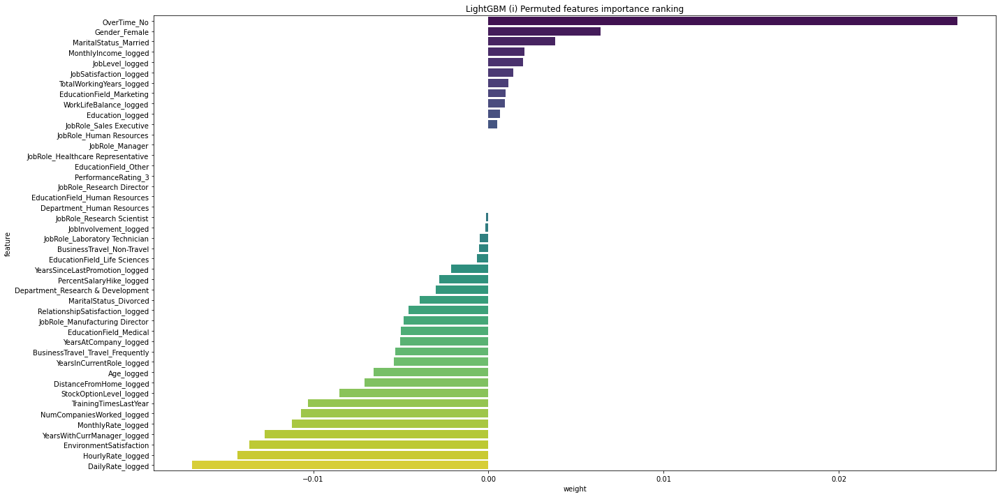

In [ ]:
###Checking permuted feature ranking

permuted_feature_ranking(lgbm_i, X_test_i, y_test_i, model_name="LightGBM (i)", standarscaler_object=None)

In [ ]:
###Partial dependence profiles
#Source: https://ema.drwhy.ai/partialDependenceProfiles.html

i_lightgbm_exp = dx.Explainer(lgbm_i, X_test_i, y_test_i, label = "IMB Lightgbm Pipeline")

pd_lgbm_n = i_lightgbm_exp.model_profile(variables=[x for x in list(X_test_i.columns)], N=100)


ld_lgbm_n = i_lightgbm_exp.model_profile(type="conditional", N=100)
ld_lgbm_n.result['_label_'] = 'LD profiles'
al_lgbm_n = i_lightgbm_exp.model_profile(type="accumulated", N=100)
al_lgbm_n.result['_label_'] = 'AL profiles'
pd_lgbm_n.plot(al_lgbm_n.plot(ld_lgbm_n, variables=[x for x in list(X_test_i.columns)]))

Preparation of a new explainer is initiated

  -> data              : 294 rows 44 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 294 values
  -> model_class       : lightgbm.sklearn.LGBMClassifier (default)
  -> label             : IMB Lightgbm Pipeline
  -> predict function  : <function yhat_proba_default at 0x7f6f45607c20> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 1.94e-07, mean = 0.896, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -1.0, mean = -0.0626, max = 0.999
  -> model_info        : package lightgbm

A new explainer has been created!


Calculating accumulated dependency: 100%|██████████| 44/44 [00:03<00:00, 11.80it/s]


In [ ]:
###TUNING RANDOM FOREST
#Source of general work-flow: https://www.analyticsvidhya.com/blog/2020/03/beginners-guide-random-forest-hyperparameter-tuning/; https://github.com/kathrinse/TabSurvey/blob/main/config/best_params.yml; https://towardsdatascience.com/hyperparameter-tuning-the-random-forest-in-python-using-scikit-learn-28d2aa77dd74; https://linuxtut.com/en/3bdae8c1098ced2dea5f/; https://github.com/optuna/optuna-examples/blob/main/xgboost/xgboost_cv.py
#Source for hyperparameter tunning: https://link-springer-com.tilburguniversity.idm.oclc.org/article/10.1007/s10462-020-09896-5/tables/2; https://wires.onlinelibrary.wiley.com/doi/full/10.1002/widm.1301?casa_token=vB15q2JbhxQAAAAA%3A34wJ3TkptdTTS7raRyDZDbK23zicE7b39SSCnMMWo4-xjwqsi8_LIeqi88_R3tTROUyqsOQCSFal3w; https://scikit-learn.org/stable/modules/ensemble.html#parameters; https://www.analyticsvidhya.com/blog/2015/06/tuning-random-forest-model/
from sklearn.ensemble import RandomForestClassifier

start = dt.now()

def Objective(trial):

    param = {
        'n_estimators': trial.suggest_int('n_estimators', 100, 2000, step=100), #!
        'max_features': trial.suggest_float('max_features', 0.25, 1.0, step=0.05), #!
        'class_weight': 'balanced_subsample',
        'criterion': 'entropy',
        'random_state': 0,
        'verbose': -1,
        }


    rf_i = RandomForestClassifier()
    
    kfold = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
    score = cross_val_score(rf_i, X_train_i, y=y_train_i, cv=kfold, scoring="f1_weighted", verbose = 0)
    f1_score_mean = score.mean()

    return f1_score_mean

study = optuna.create_study(direction="maximize", study_name='Random forest i table optimization')
study.optimize(Objective, n_trials=100)

rfc_best_params_i = study.best_params
print("Best parameters: ", rfc_best_params_i)

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

# Best parameters:  {'n_estimators': 500, 'max_features': 0.6000000000000001}
# Runtime:  126  seconds

skfold validation f1-score mean: 81.47% -||- sd: (1.84%)
train f1-score random forest:  1.0
test f1-score random forest:  0.8120119383458032


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.



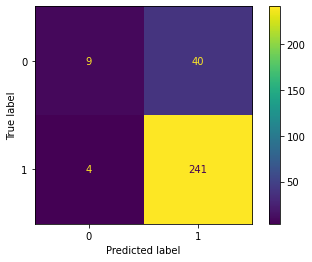

Runtime:  19  seconds


In [ ]:
###TRAINING RANDOM FOREST
from sklearn.ensemble import RandomForestClassifier

start = dt.now()

#Selecting and Preparing data
target = y_train_i
features = X_train_i
test_features = X_test_i

#Preloading model
rfc_i=RandomForestClassifier(
                             class_weight="balanced_subsample", 
                             criterion="entropy", 
                              max_features=0.6000000000000001, #!
                              n_estimators=500, #!
                             random_state=0
                             )

#Robustness check with k-fold cross-validation
kfold = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
kfold_results = cross_val_score(rfc_i, features, target, cv=kfold, scoring="f1_weighted")

#Fitting the final model on joined training and validation data
rfc_i.fit(features, target)

#Predicting the train data
y_pred_tr = rfc_i.predict(features)

#Predicting the test data
y_pred_te = rfc_i.predict((test_features))

#Checking fscore
print("skfold validation f1-score mean: %.2f%% -||- sd: (%.2f%%)" % (kfold_results.mean()*100, kfold_results.std()*100))#!

print("train f1-score random forest: ", f1_score(target, y_pred_tr, average='weighted'))


print("test f1-score random forest: ", f1_score(y_test_i, y_pred_te, average='weighted'))

plot_confusion_matrix(rfc_i, test_features, y_test_i)
plt.show()

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

In [46]:
##Random forest validation f1-score confidence interval

x = 0.8147
sd = 0.0184
TP = 241
TN = 9
FP = 40
FN = 4

print("confidence interval of cross-validation weighted f1-score: ", x," +/- ",1.959 * sd / np.sqrt(5))

print("accuracy: ", (TP+TN)/(TP+FP+FN+TN))
print("recall: ", TP/(TP+FN))
print("precision: ", TP/(TP+FP))

confidence interval of cross-validation weighted f1-score:  0.8147  +/-  0.016120082377953284
accuracy:  0.8503401360544217
recall:  0.9836734693877551
precision:  0.8576512455516014


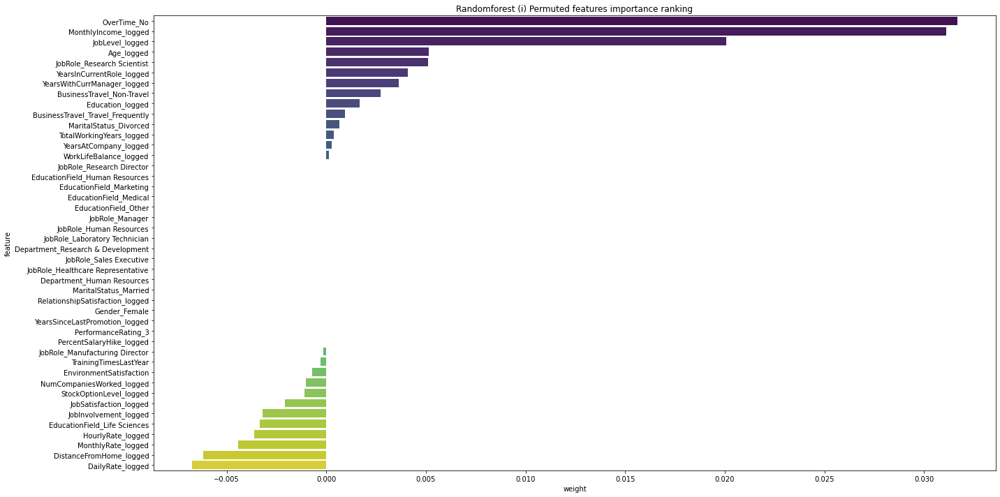

In [ ]:
###Checking permuted feature ranking

permuted_feature_ranking(rfc_i, X_test_i, y_test_i, model_name="Randomforest (i)", standarscaler_object=None)

In [ ]:
###Partial dependence profiles
#Source: https://ema.drwhy.ai/partialDependenceProfiles.html

i_rfc_exp = dx.Explainer(rfc_i, X_test_i, y_test_i, label = "IMB Randomforest Pipeline")

pd_rfc_n = i_rfc_exp.model_profile(variables=[x for x in list(X_test_i.columns)], N=100)


ld_rfc_n = i_rfc_exp.model_profile(type="conditional", N=100)
ld_rfc_n.result['_label_'] = 'LD profiles'
al_rfc_n = i_rfc_exp.model_profile(type="accumulated", N=100)
al_rfc_n.result['_label_'] = 'AL profiles'
pd_rfc_n.plot(al_rfc_n.plot(ld_rfc_n, variables=[x for x in list(X_test_i.columns)]))

Preparation of a new explainer is initiated

  -> data              : 294 rows 44 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 294 values
  -> model_class       : sklearn.ensemble._forest.RandomForestClassifier (default)
  -> label             : IMB Randomforest Pipeline
  -> predict function  : <function yhat_proba_default at 0x7f6f45607c20> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 0.184, mean = 0.842, max = 0.992
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but RandomForestClassifier was fitted with feature names



  -> residuals         : min = -0.978, mean = -0.00829, max = 0.602
  -> model_info        : package sklearn

A new explainer has been created!


Calculating accumulated dependency: 100%|██████████| 44/44 [00:04<00:00,  9.86it/s]


In [ ]:
###TUNING XGBOOST
#Source: https://github.com/optuna/optuna-examples/blob/main/xgboost/xgboost_cv.py; https://ieeexplore-ieee-org.tilburguniversity.idm.oclc.org/abstract/document/9160152; https://link-springer-com.tilburguniversity.idm.oclc.org/article/10.1007/s10462-020-09896-5/tables/2; https://github.com/optuna/optuna-examples/blob/main/xgboost/xgboost_cv.py; 
import xgboost as xgb

start = dt.now()

def m_f1_score(y_hat, data):
    y_true = data.get_label()
    y_hat = np.round(y_hat)
    return 'f1', f1_score(y_true, y_hat, average='weighted')


def objective(trial):
    (data, target) = X_train_i, y_train_i
    dtrain = xgb.DMatrix(data, label=target)

    param = {
        "verbosity": 0,
        "objective": "binary:logistic",
        "n_estimators": trial.suggest_int("n_estimators", 200, 2000, step=10), #!
        "max_depth": trial.suggest_int("max_depth", 2, 110, step=5),#!
        "criterion": "entropy",
        "class_weight": "balanced_subsample",
        "subsample": trial.suggest_float("subsample", 0.1, 1.0, step=0.1),#!
        "colsample_bylevel": trial.suggest_float("colsample_bylevel", 0.25, 1.0, step=0.05), #!
        "gamma": trial.suggest_float("gamma", 0.0, 2.0, step=0.1), #!
        "learning_rate": trial.suggest_float("learning_rate", 0.005, 0.3, step=0.005), #!
        "random_state": 0,
    }


    xgb_cv_results_i = xgb.cv(
        params=param,
        dtrain=dtrain,
        num_boost_round=10000,
        nfold=5,
        stratified=True,
        early_stopping_rounds=100,
        seed=0,
        verbose_eval=False,
        feval=m_f1_score,
    )

    best_score = xgb_cv_results_i["test-f1-mean"].values[-1]
    return best_score

if __name__ == "__main__":

    study = optuna.create_study(direction="maximize", study_name='Xgboost i table optimization')
    study.optimize(objective, n_trials=100)

    xgb_best_params_i = study.best_params
    print("Best parameters: ", xgb_best_params_i)

    running_secs = (dt.now() - start).seconds
    print("Runtime: ", running_secs, " seconds")

# Best parameters:  {'n_estimators': 640, 'max_depth': 37, 'subsample': 0.8, 'colsample_bylevel': 0.9500000000000001, 'gamma': 1.3, 'learning_rate': 0.26}
# Runtime:  340  seconds

skfold validation f1-score mean: 84.80% -||- sd: (0.72%)
train f1-score xgboost:  0.9991487411353009
test f1-score xgboost:  0.8373120201913976


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.



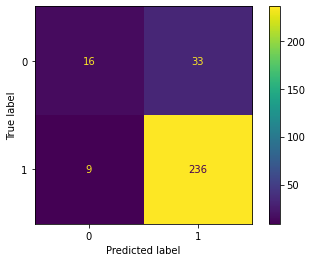

Runtime:  12  seconds


In [ ]:
###TRANING XGBOOST
import xgboost as xgb

start = dt.now()

#Selecting and Preparing data
target = y_train_i
features = X_train_i
test_features = X_test_i

#Preloading model
xgb_i = xgb.XGBClassifier(seed=0,
                           random_state=0,
                           objective='binary:logistic',
                           n_estimators=640, #!
                           max_depth=37, #!
                           eta=0.85, #!
                           criterion='entropy',
                           subsample= 0.8, #!
                           class_weight= "balanced_subsample",
                           colsample_bylevel=0.9500000000000001,#!
                           gamma=1.3,#!
                           learning_rate=0.26,#!
                           )

#Robustness check with k-fold cross-validation
kfold = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
kfold_results = cross_val_score(xgb_i, features, target, cv=kfold, scoring="f1_weighted")

#Fitting the final model on joined training and validation data
xgb_i.fit(features, target)

#Predicting the train data
y_pred_tr = xgb_i.predict(features)

#Predicting the test data
y_pred_te = xgb_i.predict(test_features)

#Checking fscore
print("skfold validation f1-score mean: %.2f%% -||- sd: (%.2f%%)" % (kfold_results.mean()*100, kfold_results.std()*100))

print("train f1-score xgboost: ", f1_score(target, y_pred_tr, average='weighted'))

print("test f1-score xgboost: ", f1_score(y_test_i, y_pred_te, average='weighted'))

plot_confusion_matrix(xgb_i, test_features, y_test_i)
plt.show()

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

In [45]:
##Xgboost validation f1-score confidence interval

x = 0.8480
sd = 0.0072
TP = 236
TN = 16
FP = 33
FN = 9

print("confidence interval of cross-validation weighted f1-score: ", x," +/- ",1.959 * sd / np.sqrt(5))

print("accuracy: ", (TP+TN)/(TP+FP+FN+TN))
print("recall: ", TP/(TP+FN))
print("precision: ", TP/(TP+FP))

confidence interval of cross-validation weighted f1-score:  0.848  +/-  0.0063078583218078065
accuracy:  0.8571428571428571
recall:  0.963265306122449
precision:  0.8773234200743495


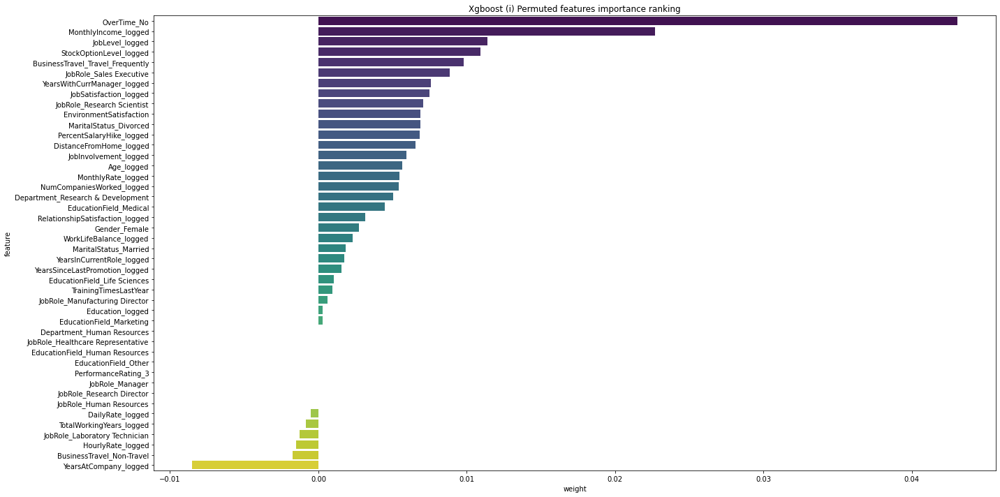

In [ ]:
###Checking permuted feature ranking

permuted_feature_ranking(xgb_i, X_test_i, y_test_i, model_name="Xgboost (i)", standarscaler_object=None)

In [ ]:
###Partial dependence profiles
#Source: https://ema.drwhy.ai/partialDependenceProfiles.html

i_xgb_exp = dx.Explainer(xgb_i, X_test_i, y_test_i, label = "IMB Xgboost Pipeline")

pd_xgb_n = i_xgb_exp.model_profile(variables=[x for x in list(X_test_i.columns)], N=100)


ld_xgb_n = i_xgb_exp.model_profile(type="conditional", N=100)
ld_xgb_n.result['_label_'] = 'LD profiles'
al_xgb_n = i_xgb_exp.model_profile(type="accumulated", N=100)
al_xgb_n.result['_label_'] = 'AL profiles'
pd_xgb_n.plot(al_xgb_n.plot(ld_xgb_n, variables=[x for x in list(X_test_i.columns)]))

Preparation of a new explainer is initiated

  -> data              : 294 rows 44 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 294 values
  -> model_class       : xgboost.sklearn.XGBClassifier (default)
  -> label             : IMB Xgboost Pipeline
  -> predict function  : <function yhat_proba_default at 0x7f6f45607c20> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.028, mean = 0.867, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.997, mean = -0.0339, max = 0.965
  -> model_info        : package xgboost

A new explainer has been created!


Calculating accumulated dependency: 100%|██████████| 44/44 [00:03<00:00, 11.14it/s]


In [ ]:
###Installing libraries

#Importing libraries and setting seed
np.random.seed(0)

In [ ]:
###TUNING TABNET
#Source of general work-flow: https://www.kaggle.com/code/neilgibbons/tuning-tabnet-with-optuna; https://github.com/dreamquark-ai/tabnet; https://optuna.readthedocs.io/en/stable/reference/generated/optuna.samplers.RandomSampler.html?highlight=random%20gridsearch; https://deepai.org/publication/tabnet-attentive-interpretable-tabular-learning
#Source fast training: https://github.com/dreamquark-ai/tabnet/issues/97
from pytorch_tabnet.tab_model import TabNetClassifier

start = dt.now()

TabNet_params = []

class F1_score(Metric):
    def __init__(self):
        self._name = "f1_score"
        self._maximize = True

    def __call__(self, y_true, y_score):
        y_score = np.where(y_score > 0.5, 1, 0)
        y_score = y_score[:,1]
        return f1_score(y_true, y_score, average="weighted")

def Objective(trial):
    mask_type = "entmax"
    n_d = trial.suggest_int("n_d", 32, 48, step=1) #!
    n_steps = trial.suggest_int("n_steps", 2, 3, step=1) #!
    gamma = trial.suggest_float("gamma", 1.0, 2.0, step=0.2) #!
    n_independent = trial.suggest_int("n_independent", 1, 4, step=1)
    n_shared = trial.suggest_int("n_shared", 1, 2, step=1)
    lambda_sparse = trial.suggest_float("lambda_sparse", 1e-6, 1e-2, log=True)
    optimizer_fn = trial.suggest_categorical("optimizer_fn", [torch.optim.Adadelta, torch.optim.Adagrad, torch.optim.Adam, torch.optim.Adamax, torch.optim.RMSprop, torch.optim.SGD])

    tabnet_params = dict(n_d=n_d, n_a=n_d, n_steps=n_steps, gamma=gamma, n_independent=n_independent,
                     lambda_sparse=lambda_sparse, optimizer_fn=optimizer_fn,
                     optimizer_params=dict(lr=2e-2, weight_decay=1e-5),#!
                     mask_type=mask_type, n_shared=n_shared,
                     scheduler_params=dict(mode="min", 
                                           patience = 5,
                                           min_lr=1e-5,#!
                                           factor=0.5),
                     scheduler_fn=torch.optim.lr_scheduler.ReduceLROnPlateau,
                     verbose=0,
                     seed=0,
                     )
    
    kf = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
    CV_score_array =[]
    X_train = X_train_i
    y_train = y_train_i

    for train_index, valid_index in kf.split(X_train.values, y_train.values):
        X_train_ix, X_valid_ix = X_train.values[train_index], X_train.values[valid_index]
        y_train_ix, y_valid_ix = y_train.values[train_index], y_train.values[valid_index]

        sc = StandardScaler()
        X_train_ix = sc.fit_transform(X_train_ix)
        X_valid_ix = sc.transform(X_valid_ix)

        classifier = TabNetClassifier(**tabnet_params)
        classifier.fit(X_train=X_train_ix, y_train=y_train_ix,
                  eval_set=[(X_train_ix, y_train_ix), (X_valid_ix, y_valid_ix)],
                  patience=10, max_epochs=50,
                  eval_metric=[F1_score], batch_size=32, virtual_batch_size=32)#!
        CV_score_array.append(classifier.best_cost)

    avg = np.mean(CV_score_array)
    return avg

study = optuna.create_study(direction="maximize", study_name='TabNet i table optimization')
study.optimize(Objective, n_trials=100)

tabnet_params_i = study.best_params
print("Best parameters: ", tabnet_params_i)

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

# Best parameters:  {'n_d': 46, 'n_steps': 2, 'gamma': 1.2, 'n_independent': 4, 'n_shared': 2, 'lambda_sparse': 0.002846675363912274, 'optimizer_fn': <class 'torch.optim.rmsprop.RMSprop'>}
# Runtime:  17034  seconds


Early stopping occurred at epoch 28 with best_epoch = 18 and best_val_1_f1_score = 0.88482
Best weights from best epoch are automatically used!

Early stopping occurred at epoch 18 with best_epoch = 8 and best_val_1_f1_score = 0.88208
Best weights from best epoch are automatically used!

Early stopping occurred at epoch 21 with best_epoch = 11 and best_val_1_f1_score = 0.86541
Best weights from best epoch are automatically used!

Early stopping occurred at epoch 20 with best_epoch = 10 and best_val_1_f1_score = 0.91469
Best weights from best epoch are automatically used!

Early stopping occurred at epoch 31 with best_epoch = 21 and best_val_1_f1_score = 0.91681
Best weights from best epoch are automatically used!

Early stopping occurred at epoch 20 with best_epoch = 10 and best_valid_f1_score = 0.90929
Best weights from best epoch are automatically used!


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:444: UserWarning:

X has feature names, but StandardScaler was fitted without feature names

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:444: UserWarning:

X has feature names, but StandardScaler was fitted without feature names



skfold validation f1-score mean: 89.28% -||- sd: (1.99%)
train f1_score of tabnet:  0.942722834907035
test f1_score of tabnet:  0.8436023622047244
Runtime:  189  seconds


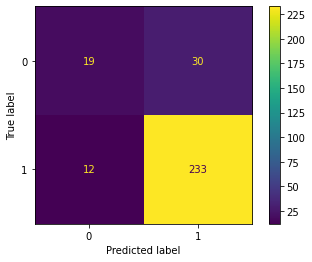

In [ ]:
###TRAINING TABNET
#Source: https://github.com/dreamquark-ai/tabnet, https://www.stackvidhya.com/plot-confusion-matrix-in-python-and-why/
from pytorch_tabnet.tab_model import TabNetClassifier

start = dt.now()

class F1_score(Metric):
    def __init__(self):
        self._name = "f1_score"
        self._maximize = True

    def __call__(self, y_true, y_score):
        y_score = np.where(y_score > 0.5, 1, 0)
        y_score = y_score[:,1]
        return f1_score(y_true, y_score, average="weighted")

#Selecting and Preparing data
X_train = X_train_i
y_train = y_train_i

n_total_train = len(X_train)

train_indices, valid_indices = train_test_split(range(n_total_train), test_size=0.2, random_state=0)

#Preloading model
tb_i = TabNetClassifier(
    n_d=46,
    n_a=46,
    n_steps=2,
    gamma=1.2,
    n_independent=4,
    n_shared=2,
    lambda_sparse=0.002846675363912274,
    optimizer_fn=torch.optim.RMSprop,
    optimizer_params=dict(lr=2e-2, weight_decay=1e-5),
    scheduler_params = dict(mode="min",
                            patience=5,
                            min_lr=1e-5,
                            factor=0.5),
    scheduler_fn=torch.optim.lr_scheduler.ReduceLROnPlateau,
    mask_type='entmax',
    seed=0,
    verbose=0
)

X_train_tb = X_train.values[train_indices] 
y_train_tb = y_train.values[train_indices]

X_valid_tb = X_train.values[valid_indices]
y_valid_tb = y_train.values[valid_indices]

sc_2 = StandardScaler()
X_train_tb = sc_2.fit_transform(X_train_tb)
X_valid_tb = sc_2.transform(X_valid_tb)

#Robustness check with k-fold cross-validation#!

kf = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
CV_score_array =[]

for train_index, valid_index in kf.split(X_train.values, y_train.values):
    X_train_ix, X_valid_ix = X_train.values[train_index], X_train.values[valid_index]
    y_train_ix, y_valid_ix = y_train.values[train_index], y_train.values[valid_index]

    sc = StandardScaler()
    X_train_ix = sc.fit_transform(X_train_ix)
    X_valid_ix = sc.transform(X_valid_ix)

    tb_i.fit(X_train=X_train_ix, y_train=y_train_ix,
              eval_set=[(X_train_ix, y_train_ix), (X_valid_ix, y_valid_ix)],
              patience=10, max_epochs=50,
              eval_metric=[F1_score], batch_size=32, virtual_batch_size=32)
    CV_score_array.append(tb_i.best_cost)

avg = np.mean(CV_score_array)
sd = np.std(CV_score_array)

#Fitting the final model on joined training and validation data

max_epochs = 50

tb_i.fit(
    X_train=X_train_tb, y_train=y_train_tb,
    eval_set=[(X_train_tb, y_train_tb), (X_valid_tb, y_valid_tb)],
    eval_name=['train', 'valid'],
    eval_metric=[F1_score],
    max_epochs=max_epochs,
    patience=10,
    batch_size=32, virtual_batch_size=32
)

preds_mapper = { idx : class_name for idx, class_name in enumerate(tb_i.classes_)}

#Predicting the train data
preds_i_tr = tb_i.predict(sc_2.transform(X_train_i))

#Predicting the test data
preds_i_te = tb_i.predict(sc_2.transform(X_test_i))

print("skfold validation f1-score mean: %.2f%% -||- sd: (%.2f%%)" % (avg*100, sd*100))#!

print("train f1_score of tabnet: ",f1_score(y_pred=preds_i_tr, y_true=y_train_i, average='weighted'))

print("test f1_score of tabnet: ",f1_score(y_pred=preds_i_te, y_true=y_test_i, average='weighted'))

cf_matrix = confusion_matrix(y_test_i, preds_i_te)
disp = ConfusionMatrixDisplay(confusion_matrix=cf_matrix)
disp.plot()

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

In [44]:
##TABNET validation f1-score confidence interval

x = 0.8928
sd = 0.0199
TP = 233
TN = 19
FP = 30
FN = 12

print("confidence interval of cross-validation weighted f1-score: ", x," +/- ",1.959 * sd / np.sqrt(5))

print("accuracy: ", (TP+TN)/(TP+FP+FN+TN))
print("recall: ", TP/(TP+FN))
print("precision: ", TP/(TP+FP))

confidence interval of cross-validation weighted f1-score:  0.8928  +/-  0.01743421952832991
accuracy:  0.8571428571428571
recall:  0.9510204081632653
precision:  0.8859315589353612


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:444: UserWarning:

X has feature names, but StandardScaler was fitted without feature names



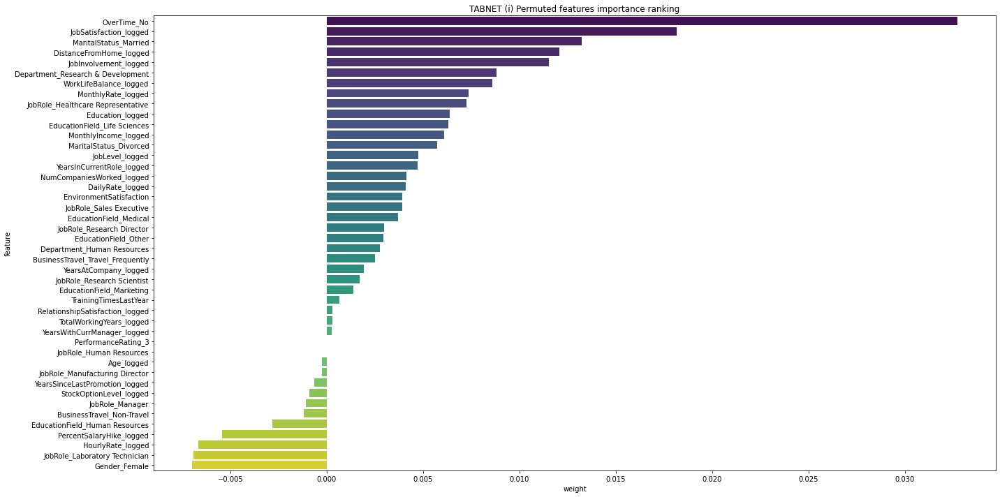

In [ ]:
###Checking permuted feature ranking

permuted_feature_ranking(tb_i, X_test_i, y_test_i, model_name="TABNET (i)", standarscaler_object=sc_2)

In [ ]:
###Generate Feature importance heatmap
#Source: https://www.kaggle.com/code/mmkuznecov/tabnet-catboost-flaml

#Extracting the explainability parameters
explainability_matrix , masks = tb_i.explain(sc_2.transform(X_test_i))

#Normalize the importance by sample
normalized_explain_mat = np.divide(explainability_matrix, explainability_matrix.sum(axis=1).reshape(-1, 1)+1e-8)

#Add prediction to better understand correlation between features and predictions
val_preds = tb_i.predict(sc_2.transform(X_test_i))

explain_and_preds = np.hstack([normalized_explain_mat, val_preds.reshape(-1, 1)])

features = [i for i in list(X_test_i.columns)]

px.imshow(explain_and_preds[:,:],
          labels=dict(x="Features", y="Samples", color="Importance"),
          x=features+["prediction"],
          title="Sample wise feature importance",
          color_continuous_scale='viridis',
          height=1000)

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:444: UserWarning:

X has feature names, but StandardScaler was fitted without feature names

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:444: UserWarning:

X has feature names, but StandardScaler was fitted without feature names



#HRA dt

In [3]:
###Separating differently encoded variables

float_features_h = hradt_df.loc[:, ["city_development_index", "training_hours"]] #numeric
dummy_features_h = hradt_df.loc[:, ["relevant_experience","city"]] #dummy
label_features_h = hradt_df.loc[:, ["enrolled_university", "education_level", "major_discipline", "experience", "company_size", "company_type", "last_new_job", "gender"]]
target_variable_h = hradt_df.loc[:, ["target"]] #target variable
target_variable_h = target_variable_h.replace({"target": {1: 0, 0: 1}})

In [4]:
###LabelEncoder with memory
#Source: https://python.tutorialink.com/how-to-reverse-label-encoder-from-sklearn-for-multiple-columns/
from sklearn.preprocessing import LabelEncoder

class MultiColumnLabelEncoder:

    def __init__(self, columns=None):
        self.columns = columns # array of column names to encode


    def fit(self, X, y=None):
        self.encoders = {}
        columns = X.columns if self.columns is None else self.columns
        for col in columns:
            self.encoders[col] = LabelEncoder().fit(X[col])
        return self


    def transform(self, X):
        output = X.copy()
        columns = X.columns if self.columns is None else self.columns
        for col in columns:
            output[col] = self.encoders[col].transform(X[col])
        return output


    def fit_transform(self, X, y=None):
        return self.fit(X,y).transform(X)


    def inverse_transform(self, X):
        output = X.copy()
        columns = X.columns if self.columns is None else self.columns
        for col in columns:
            output[col] = self.encoders[col].inverse_transform(X[col])
        return output

In [5]:
###Encoding features

multi = MultiColumnLabelEncoder(columns=["enrolled_university", "education_level", "major_discipline", "experience", "company_size", "company_type", "last_new_job", "gender"])

label_features_h = label_features_h.values.astype(str)
label_features_h = pd.DataFrame(label_features_h, columns=["enrolled_university", "education_level", "major_discipline", "experience", "company_size", "company_type", "last_new_job", "gender"])
label_features_h = multi.fit_transform(label_features_h)

dummy_features_h = pd.concat([pd.get_dummies(dummy_features_h['relevant_experience'], prefix='relevant_experience').iloc[:,0],pd.get_dummies(dummy_features_h['city'], prefix='city').iloc[:,0:122]],axis=1)

In [6]:
###Concat all subdfs into 1

concated_df_h = pd.concat([float_features_h, dummy_features_h, label_features_h, target_variable_h], axis=1)

In [7]:
###Refilling NANs for missing data imputation

concated_df_h.loc[:, "gender"] = concated_df_h.loc[:, "gender"].replace(3,np.nan)
concated_df_h.loc[:, "enrolled_university"] = concated_df_h.loc[:, "enrolled_university"].replace(2,np.nan)
concated_df_h.loc[:, "education_level"] = concated_df_h.loc[:, "education_level"].replace(5,np.nan)
concated_df_h.loc[:, "major_discipline"] = concated_df_h.loc[:, "major_discipline"].replace(6,np.nan)
concated_df_h.loc[:, "experience"] = concated_df_h.loc[:, "experience"].replace(22,np.nan)
concated_df_h.loc[:, "company_size"] = concated_df_h.loc[:, "company_size"].replace(8,np.nan)
concated_df_h.loc[:, "company_type"] = concated_df_h.loc[:, "company_type"].replace(6,np.nan)
concated_df_h.loc[:, "last_new_job"] = concated_df_h.loc[:, "last_new_job"].replace(5,np.nan)

In [8]:
###Missing data imputation
from sklearn.ensemble import ExtraTreesRegressor

imp = IterativeImputer(estimator=ExtraTreesRegressor(), max_iter=3, random_state=0)

concated_df_h.loc[:, :] = imp.fit_transform(concated_df_h)

/usr/local/lib/python3.7/dist-packages/sklearn/impute/_iterative.py:701: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  ConvergenceWarning,


In [9]:
###Round up float values for integer type conversion

j = 0
for i in concated_df_h["enrolled_university"]:
  concated_df_h["enrolled_university"][j] = round(i,0)
  j+=1

k = 0
for l in concated_df_h["gender"]:
  if round(l,0) > 2.0:
    concated_df_h["gender"][k] = 2.0
  else:
    concated_df_h["gender"][k] = round(l,0)
  k+=1

In [10]:
###Reverse label encode features
label_list = ["enrolled_university", "education_level", "major_discipline", "experience", "company_size", "company_type", "last_new_job", "gender"]

for i in label_list:
  concated_df_h[i] = concated_df_h[i].astype("int")

concated_df_h = multi.inverse_transform(concated_df_h)

In [11]:
###Dummy encode the reversed features

label_list = ["enrolled_university", "education_level", "major_discipline", "experience", "company_size", "company_type", "last_new_job", "gender"]
concated_df_h_2 = copy.deepcopy(concated_df_h)

for i in label_list:
  concated_df_h_2[i] = pd.get_dummies(concated_df_h_2[i], prefix=i).iloc[:,(len(set(concated_df_h_2[i]))-1)]

In [12]:
###Log scaling not normal feature data distributions

concated_df_h_2.loc[:,["city_development_index", "training_hours"]]+=1
concated_log_df_h = np.log(concated_df_h_2.loc[:,["city_development_index", "training_hours"]])
concated_df_h_2 = concated_df_h_2.drop(["city_development_index", "training_hours"], axis = 1)

In [13]:
###Splitting data

concated_df_h = pd.concat([concated_log_df_h, concated_df_h_2], axis=1)
X_h = concated_df_h.iloc[:,:-1]
y_h = concated_df_h.iloc[:,-1]

X_train_h, X_test_h, y_train_h, y_test_h = train_test_split(X_h, y_h, test_size=0.2, random_state=0)

In [14]:
###Rename logged headers for graphs

X_test_h = X_test_h.rename(columns={"city_development_index": "city_development_index_logged", "training_hours": "training_hours_logged"})
X_train_h = X_train_h.rename(columns={"city_development_index": "city_development_index_logged", "training_hours": "training_hours_logged"})

In [15]:
###Permuted feature importance
#Source: https://eli5.readthedocs.io/en/latest/autodocs/formatters.html#module-eli5.formatters.as_dataframe, https://eli5.readthedocs.io/en/latest/blackbox/permutation_importance.html; https://buildmedia.readthedocs.org/media/pdf/eli5/stable/eli5.pdf

def permuted_feature_ranking(classifier, X, y, model_name="model", standarscaler_object=None):

  def score_1(classifier, X, y):
    y_pred = classifier.predict(X)
    return f1_score(y_true=y, y_pred=y_pred, average='weighted')
  def score_2(X, y):
    y_pred = classifier.predict(X)
    return f1_score(y_true=y, y_pred=y_pred, average='weighted')

  try:
    permutation_importance = PermutationImportance(classifier, scoring=score_1, random_state=0, n_iter=25)
    permuted_feature_importances = permutation_importance.fit(X, y)
    df = eli5.explain_weights_df(permuted_feature_importances, feature_names = list(X.columns))
    plt.figure(figsize=(40, 20))
    sns.barplot(x="weight", y="feature", data=df.sort_values(by="weight", ascending=False), palette="viridis")
    plt.title(f'{model_name} Permuted features importance ranking')
    plt.tight_layout()
    plt.show()

  except:
    base_score, score_decreases = get_score_importances(score_2, standarscaler_object.transform(X), y, n_iter=25)
    permuted_feature_importances = np.mean(score_decreases, axis=0)
    permuted_feature_importances = permuted_feature_importances.tolist()
    temp_dict = {'feature':X.columns,'weight':permuted_feature_importances}
    df = pd.DataFrame(data=temp_dict, columns=["feature","weight"])
    plt.figure(figsize=(40, 20))
    sns.barplot(x="weight", y="feature", data=df.sort_values(by="weight", ascending=False), palette="viridis")
    plt.title(f'{model_name} Permuted features importance ranking')
    plt.tight_layout()
    plt.show()

In [ ]:
#Hyperparameter tunning of baseline Logit model
from sklearn.linear_model import LogisticRegression

start = dt.now()

def m_f1_score(y_hat, data):
    y_true = data.get_label()
    y_hat = np.round(y_hat)
    return 'f1', f1_score(y_true, y_hat, average='weighted'), True

def Objective(trial):

    param = {
        'C' : trial.suggest_loguniform("C", 1e-2, 1),
        'random_state':0,
        'verbose':1
        }

    kf = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
    CV_score_array =[]

    X_train = X_train_h
    y_train = y_train_h

    for train_index, valid_index in kf.split(X_train, y_train):
        evals_result = []
        train_ix, valid_ix = X_train.values[train_index], X_train.values[valid_index]
        train_iy, valid_iy = y_train.values[train_index], y_train.values[valid_index]
        logit = LogisticRegression(**param)
        logit.fit(train_ix, train_iy)
        y_pred = logit.predict(valid_ix)
        evals_result = f1_score(valid_iy, y_pred, average='weighted')

        print("evals_result f1_score:", evals_result)
        CV_score_array.append(evals_result)

    avg = np.mean(CV_score_array)
    return avg

study = optuna.create_study(direction="maximize", study_name='Logit h table optimization')
study.optimize(Objective, n_trials=25)

logit_best_params_h = study.best_params
print("Best parameters: ", logit_best_params_h)

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

# Best parameters:  {'C': 0.9519191507819867}
# Runtime:  42  seconds

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


skfold validation f1-score mean: 74.09% -||- sd: (0.51%)
train f1-score logit:  0.7436840898163112
test f1-score logit:  0.7412439904200965


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


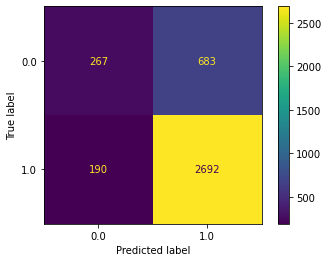

Runtime:  2  seconds


In [17]:
#Train baseline Logit model
#Source: https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html
from sklearn.linear_model import LogisticRegression

start = dt.now()

#Selecting and Preparing data
target = y_train_h
features = X_train_h
test_features = X_test_h

#Preloading model#!
logit_h_baseline = LogisticRegression(C=0.9519191507819867, random_state=0)

#Robustness check with k-fold cross-validation#!

kfold = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
kfold_results = cross_val_score(logit_h_baseline, features, target, cv=kfold, scoring="f1_weighted")

#Fitting the final model on joined training and validation data#!
logit_h_baseline.fit(features, target)

#Predicting the train data
y_pred_tr = logit_h_baseline.predict(features)

#Predicting the test data
y_pred_te = logit_h_baseline.predict(test_features)

#Checking fscore
print("skfold validation f1-score mean: %.2f%% -||- sd: (%.2f%%)" % (kfold_results.mean()*100, kfold_results.std()*100))

print("train f1-score logit: ", f1_score(target, y_pred_tr, average='weighted'))

print("test f1-score logit: ", f1_score(y_test_h, y_pred_te, average='weighted'))

plot_confusion_matrix(logit_h_baseline, test_features, y_test_h)
plt.show()

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

In [43]:
##Logit validation f1-score confidence interval
x = 0.7404
sd = 0.0049
TP = 2692
TN = 267
FP = 683
FN = 190

print("confidence interval of cross-validation weighted f1-score: ", x," +/- ",1.959 * sd / np.sqrt(5))

print("accuracy: ", (TP+TN)/(TP+FP+FN+TN))
print("recall: ", TP/(TP+FN))
print("precision: ", TP/(TP+FP))

confidence interval of cross-validation weighted f1-score:  0.7404  +/-  0.0042928480245636455
accuracy:  0.7721816283924844
recall:  0.9340735600277585
precision:  0.7976296296296296


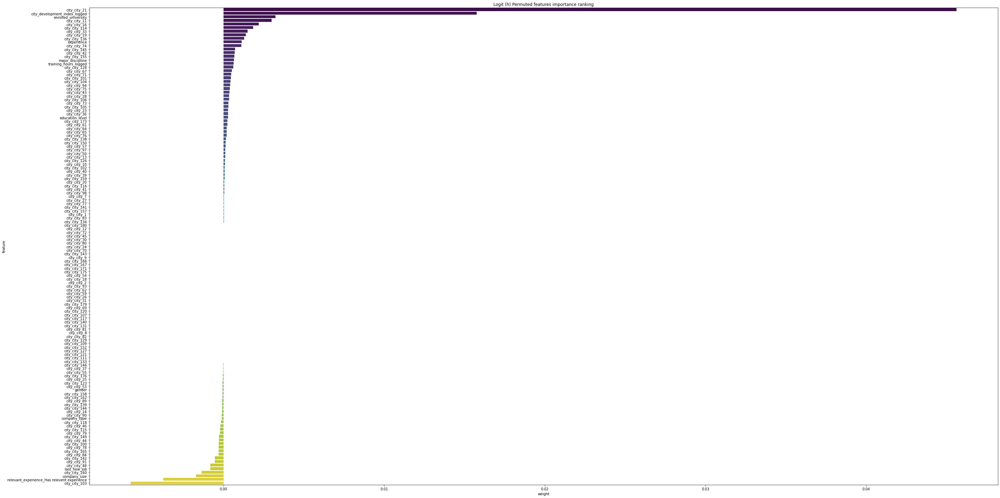

In [18]:
###Checking permuted feature ranking

permuted_feature_ranking(logit_h_baseline, X_test_h, y_test_h, model_name="Logit (h)", standarscaler_object=None)

In [19]:
###Partial dependence profiles
#Source: https://ema.drwhy.ai/partialDependenceProfiles.html

h_logit_exp = dx.Explainer(logit_h_baseline, X_test_h, y_test_h, label = "HRA Logit Pipeline")

pd_logit_n = h_logit_exp.model_profile(variables=[x for x in list(X_test_h.columns)], N=25)

ld_logit_n = h_logit_exp.model_profile(type="conditional", N=25)
ld_logit_n.result['_label_'] = 'LD profiles'
al_logit_n = h_logit_exp.model_profile(type="accumulated", N=25)
al_logit_n.result['_label_'] = 'AL profiles'
pd_logit_n.plot(al_logit_n.plot(ld_logit_n, variables=[x for x in list(X_test_h.columns)]))

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  "X does not have valid feature names, but"


Preparation of a new explainer is initiated

  -> data              : 3832 rows 133 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 3832 values
  -> model_class       : sklearn.linear_model._logistic.LogisticRegression (default)
  -> label             : HRA Logit Pipeline
  -> predict function  : <function yhat_proba_default at 0x7f2727031680> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 0.165, mean = 0.754, max = 0.978
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.966, mean = -0.00189, max = 0.835
  -> model_info        : package sklearn

A new explainer has been created!


Calculating accumulated dependency: 100%|██████████| 133/133 [00:05<00:00, 23.86it/s]


In [ ]:
###TUNING LIGHTGBM
#Source of general work-flow: https://github.com/optuna/optuna-examples/blob/main/lightgbm/lightgbm_simple.py; https://www.kaggle.com/code/code1110/dsb19-lgb-hyperparameter-tuning-optuna/notebook; https://medium.com/analytics-vidhya/hyperparameters-optimization-for-lightgbm-catboost-and-xgboost-regressors-using-bayesian-6e7c495947a9; https://medium.com/@pushkarmandot/https-medium-com-pushkarmandot-what-is-lightgbm-how-to-implement-it-how-to-fine-tune-the-parameters-60347819b7fc 
#Source of hyperparameter tunnning:  https://lightgbm.readthedocs.io/en/latest/Parameters-Tuning.html; https://ieeexplore-ieee-org.tilburguniversity.idm.oclc.org/abstract/document/9599143; https://link-springer-com.tilburguniversity.idm.oclc.org/article/10.1007/s10462-020-09896-5/tables/2
import lightgbm as lgbm

start = dt.now()

def m_f1_score(y_hat, data):
    y_true = data.get_label()
    y_hat = np.round(y_hat)
    return 'f1', f1_score(y_true, y_hat, average='weighted'), True

def Objective(trial):

    param = {
        'is_unbalance': True,#!
        'boosting_type': trial.suggest_categorical('boosting_type',['gbdt','dart']),#!
        'n_estimators': trial.suggest_int('n_estimators', 100, 2000, step=100),#!
        'num_leaves': trial.suggest_int('num_leaves', 10, 150, step=10),#!
        'learning_rate': trial.suggest_float("learning_rate", 0.005, 0.5, step=0.005),#!
        'verbose': -1,
        'seed': 0
        }

    kf = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
    CV_score_array =[]

    X_train = X_train_h
    y_train = y_train_h

    for train_index, valid_index in kf.split(X_train, y_train):
        evals_result = {}
        train_ix, valid_ix = X_train.values[train_index], X_train.values[valid_index]
        train_iy, valid_iy = y_train.values[train_index], y_train.values[valid_index]
        dtrain = lgbm.Dataset(train_ix, label=train_iy)
        dvalid = lgbm.Dataset(valid_ix, label=valid_iy)
        lgbm.train(param, dtrain, valid_sets=dvalid, feval=m_f1_score, evals_result=evals_result, verbose_eval=False, num_boost_round=10000)
        print("evals_result", evals_result)
        CV_score_array.append(max(evals_result["valid_0"]["f1"]))

    avg = np.mean(CV_score_array)
    return avg

study = optuna.create_study(direction="maximize", study_name='Lightgbm h table optimization')
study.optimize(Objective, n_trials=25)

lgb_best_params_h = study.best_params
print("Best parameters: ", lgb_best_params_h)

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

# Best parameters:  {'boosting_type': 'dart', 'n_estimators': 1200, 'num_leaves': 10, 'learning_rate': 0.195}
# Runtime:  2147  seconds

skfold validation f1-score mean: 74.69% -||- sd: (0.55%)
train f1-score lightgbm:  0.7780059059211084
test f1-score lightgbm:  0.7533659921147103


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.



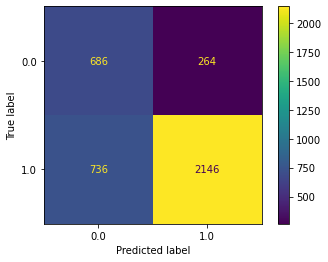

Runtime:  51  seconds


In [20]:
###TRAINING LIGHTGBM
import lightgbm as lgbm

start = dt.now()

#Selecting and Preparing data
target = y_train_h
features = X_train_h
test_features = X_test_h

#Setting best fine tuned model                     
lgbm_h = lgbm.LGBMClassifier(boosting_type = 'dart', #!
                          is_unbalance = True, #!
                          learning_rate = 0.195, #!
                          n_estimators = 1200,#!
                          num_leaves = 10,#!
                          seed=0)

#Robustness check with k-fold cross-validation#!

kfold = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
kfold_results = cross_val_score(lgbm_h, features, target, cv=kfold, scoring="f1_weighted")

#Fitting the final model on joined training and validation data
lgbm_h = lgbm_h.fit(features, target)

#Predicting the train data
y_pred_tr = lgbm_h.predict(features)

#Predicting the test data
y_pred_te = lgbm_h.predict(test_features)

#Checking fscore
print("skfold validation f1-score mean: %.2f%% -||- sd: (%.2f%%)" % (kfold_results.mean()*100, kfold_results.std()*100))

print("train f1-score lightgbm: ", f1_score(target, y_pred_tr, average='weighted'))

print("test f1-score lightgbm: ", f1_score(y_test_h, y_pred_te, average='weighted'))

plot_confusion_matrix(lgbm_h, test_features, y_test_h)
plt.show()

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

In [42]:
##Lightgbm validation f1-score confidence interval

x = 0.7469
sd = 0.0055
TP = 2146
TN = 686
FP = 264
FN = 736

print("confidence interval of cross-validation weighted f1-score: ", x," +/- ",1.959 * sd / np.sqrt(5))

print("accuracy: ", (TP+TN)/(TP+FP+FN+TN))
print("recall: ", TP/(TP+FN))
print("precision: ", TP/(TP+FP))

confidence interval of cross-validation weighted f1-score:  0.7469  +/-  0.004818502884714296
accuracy:  0.7390396659707724
recall:  0.7446217904233171
precision:  0.8904564315352697


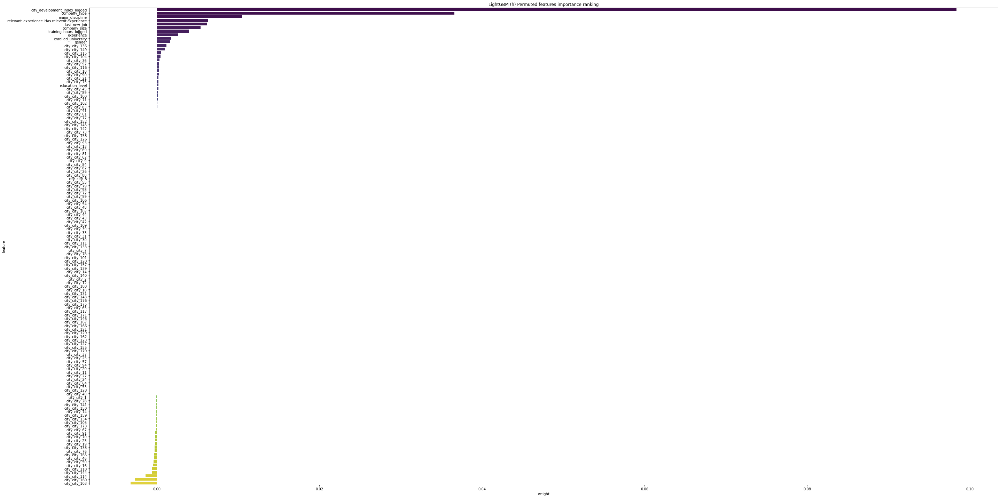

In [21]:
###Checking permuted feature ranking

permuted_feature_ranking(lgbm_h, X_test_h, y_test_h, model_name="LightGBM (h)", standarscaler_object=None)

In [22]:
###Partial dependence profiles
#Source: https://ema.drwhy.ai/partialDependenceProfiles.html

h_lightgbm_exp = dx.Explainer(lgbm_h, X_test_h, y_test_h, label = "HRA Lightgbm Pipeline")

pd_lgbm_n = h_lightgbm_exp.model_profile(variables=[x for x in list(X_test_h.columns)], N=25)

ld_lgbm_n = h_lightgbm_exp.model_profile(type="conditional", N=25)
ld_lgbm_n.result['_label_'] = 'LD profiles'
al_lgbm_n = h_lightgbm_exp.model_profile(type="accumulated", N=25)
al_lgbm_n.result['_label_'] = 'AL profiles'
pd_lgbm_n.plot(al_lgbm_n.plot(ld_lgbm_n, variables=[x for x in list(X_test_h.columns)]))

Preparation of a new explainer is initiated

  -> data              : 3832 rows 133 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 3832 values
  -> model_class       : lightgbm.sklearn.LGBMClassifier (default)
  -> label             : HRA Lightgbm Pipeline
  -> predict function  : <function yhat_proba_default at 0x7f2727031680> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 0.0738, mean = 0.592, max = 0.999
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.996, mean = 0.16, max = 0.912
  -> model_info        : package lightgbm

A new explainer has been created!


Calculating accumulated dependency: 100%|██████████| 133/133 [00:05<00:00, 23.73it/s]


In [ ]:
###TUNING RANDOM FOREST
#Source of general work-flow: https://www.analyticsvidhya.com/blog/2020/03/beginners-guide-random-forest-hyperparameter-tuning/; https://github.com/kathrinse/TabSurvey/blob/main/config/best_params.yml; https://towardsdatascience.com/hyperparameter-tuning-the-random-forest-in-python-using-scikit-learn-28d2aa77dd74; https://linuxtut.com/en/3bdae8c1098ced2dea5f/; https://github.com/optuna/optuna-examples/blob/main/xgboost/xgboost_cv.py
#Source for hyperparameter tunning: https://link-springer-com.tilburguniversity.idm.oclc.org/article/10.1007/s10462-020-09896-5/tables/2; https://wires.onlinelibrary.wiley.com/doi/full/10.1002/widm.1301?casa_token=vB15q2JbhxQAAAAA%3A34wJ3TkptdTTS7raRyDZDbK23zicE7b39SSCnMMWo4-xjwqsi8_LIeqi88_R3tTROUyqsOQCSFal3w; https://scikit-learn.org/stable/modules/ensemble.html#parameters; https://www.analyticsvidhya.com/blog/2015/06/tuning-random-forest-model/
from sklearn.ensemble import RandomForestClassifier

start = dt.now()

def Objective(trial):

    param = {
        'n_estimators': trial.suggest_int('n_estimators', 100, 2000, step=100), #!
        'max_features': trial.suggest_float('max_features', 0.25, 1.0, step=0.05), #!
        'class_weight': 'balanced_subsample',
        'criterion': 'entropy',
        'random_state': 0,
        'verbose': -1,
        }


    rf_h = RandomForestClassifier()
    
    kfold = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
    score = cross_val_score(rf_h, X_train_h, y=y_train_h, cv=kfold, scoring="f1_weighted", verbose = 0)
    f1_score_mean = score.mean()

    return f1_score_mean

study = optuna.create_study(direction="maximize", study_name='Random forest h table optimization')
study.optimize(Objective, n_trials=25)

rfc_best_params_h = study.best_params
print("Best parameters: ", rfc_best_params_h)

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

# Best parameters:  {'n_estimators': 600, 'max_features': 0.8500000000000001}
# Runtime:  252  seconds

skfold validation f1-score mean: 73.23% -||- sd: (0.55%)
train f1-score random forest:  0.9409472311873047
test f1-score random forest:  0.738573764057893


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.



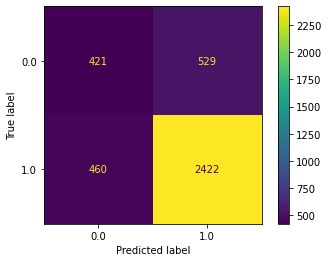

Runtime:  191  seconds


In [23]:
###TRAINING RANDOM FOREST
from sklearn.ensemble import RandomForestClassifier

start = dt.now()

#Selecting and Preparing data
target = y_train_h
features = X_train_h
test_features = X_test_h

#Preloading model
rfc_h=RandomForestClassifier(
                             class_weight="balanced_subsample", 
                             criterion="entropy", 
                              max_features=0.8500000000000001, #!
                              n_estimators=600, #!
                             random_state=0
                             )

#Robustness check with k-fold cross-validation
kfold = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
kfold_results = cross_val_score(rfc_h, features, target, cv=kfold, scoring="f1_weighted")

#Fitting the final model on joined training and validation data
rfc_h.fit(features, target)

#Predicting the train data
y_pred_tr = rfc_h.predict(features)

#Predicting the test data
y_pred_te = rfc_h.predict((test_features))

#Checking fscore
print("skfold validation f1-score mean: %.2f%% -||- sd: (%.2f%%)" % (kfold_results.mean()*100, kfold_results.std()*100))#!

print("train f1-score random forest: ", f1_score(target, y_pred_tr, average='weighted'))


print("test f1-score random forest: ", f1_score(y_test_h, y_pred_te, average='weighted'))

plot_confusion_matrix(rfc_h, test_features, y_test_h)
plt.show()

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

In [41]:
##Random forest validation f1-score confidence interval

x = 0.7323
sd = 0.0055
TP = 2422
TN = 421
FP = 529
FN = 460

print("confidence interval of cross-validation weighted f1-score: ", x," +/- ",1.959 * sd / np.sqrt(5))

print("accuracy: ", (TP+TN)/(TP+FP+FN+TN))
print("recall: ", TP/(TP+FN))
print("precision: ", TP/(TP+FP))

confidence interval of cross-validation weighted f1-score:  0.7323  +/-  0.004818502884714296
accuracy:  0.7419102296450939
recall:  0.8403886190145732
precision:  0.8207387326330058


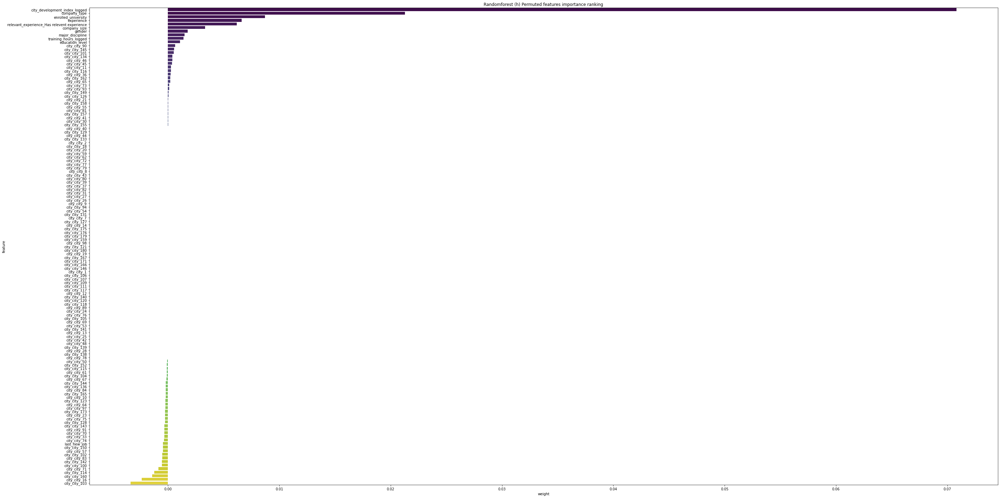

In [24]:
###Checking permuted feature ranking

permuted_feature_ranking(rfc_h, X_test_h, y_test_h, model_name="Randomforest (h)", standarscaler_object=None)

In [25]:
###Partial dependence profiles
#Source: https://ema.drwhy.ai/partialDependenceProfiles.html

h_rfc_exp = dx.Explainer(rfc_h, X_test_h, y_test_h, label = "HRA Randomforest Pipeline")

pd_rfc_n = h_rfc_exp.model_profile(variables=[x for x in list(X_test_h.columns)], N=25)

ld_rfc_n = h_rfc_exp.model_profile(type="conditional", N=25)
ld_rfc_n.result['_label_'] = 'LD profiles'
al_rfc_n = h_rfc_exp.model_profile(type="accumulated", N=25)
al_rfc_n.result['_label_'] = 'AL profiles'
pd_rfc_n.plot(al_rfc_n.plot(ld_rfc_n, variables=[x for x in list(X_test_h.columns)]))

Preparation of a new explainer is initiated

  -> data              : 3832 rows 133 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 3832 values
  -> model_class       : sklearn.ensemble._forest.RandomForestClassifier (default)
  -> label             : HRA Randomforest Pipeline
  -> predict function  : <function yhat_proba_default at 0x7f2727031680> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but RandomForestClassifier was fitted with feature names



  -> predicted values  : min = 0.000953, mean = 0.737, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -1.0, mean = 0.0147, max = 0.999
  -> model_info        : package sklearn

A new explainer has been created!


Calculating accumulated dependency: 100%|██████████| 133/133 [00:05<00:00, 24.02it/s]


In [ ]:
###TUNING XGBOOST
#Source: https://github.com/optuna/optuna-examples/blob/main/xgboost/xgboost_cv.py; https://ieeexplore-ieee-org.tilburguniversity.idm.oclc.org/abstract/document/9160152; https://link-springer-com.tilburguniversity.idm.oclc.org/article/10.1007/s10462-020-09896-5/tables/2; https://github.com/optuna/optuna-examples/blob/main/xgboost/xgboost_cv.py
import xgboost as xgb

start = dt.now()

def m_f1_score(y_hat, data):
    y_true = data.get_label()
    y_hat = np.round(y_hat)
    return 'f1', f1_score(y_true, y_hat, average='weighted')


def objective(trial):
    (data, target) = X_train_h, y_train_h
    dtrain = xgb.DMatrix(data, label=target)

    param = {
        "verbosity": 0,
        "objective": "binary:logistic",
        "n_estimators": trial.suggest_int("n_estimators", 200, 2000, step=10), #!
        "max_depth": trial.suggest_int("max_depth", 2, 110, step=5),#!
        "criterion": "entropy",
        "class_weight": "balanced_subsample",
        "subsample": trial.suggest_float("subsample", 0.1, 1.0, step=0.1),#!
        "colsample_bylevel": trial.suggest_float("colsample_bylevel", 0.25, 1.0, step=0.05), #!
        "gamma": trial.suggest_float("gamma", 0.0, 2.0, step=0.1), #!
        "learning_rate": trial.suggest_float("learning_rate", 0.005, 0.3, step=0.005), #!
        "random_state": 0,
    }


    xgb_cv_results_h = xgb.cv(
        params=param,
        dtrain=dtrain,
        num_boost_round=10000,
        nfold=5,
        stratified=True,
        early_stopping_rounds=100,
        seed=0,
        verbose_eval=False,
        feval=m_f1_score,
    )

    best_score = xgb_cv_results_h["test-f1-mean"].values[-1]
    return best_score

if __name__ == "__main__":

    study = optuna.create_study(direction="maximize", study_name='Xgboost h table optimization')
    study.optimize(objective, n_trials=25)

    xgb_best_params_h = study.best_params
    print("Best parameters: ", xgb_best_params_h)

    running_secs = (dt.now() - start).seconds
    print("Runtime: ", running_secs, " seconds")

# Best parameters:  {'n_estimators': 760, 'max_depth': 2, 'subsample': 1.0, 'colsample_bylevel': 0.75, 'gamma': 1.9000000000000001, 'learning_rate': 0.27}
# Runtime:  4366  seconds

skfold validation f1-score mean: 76.57% -||- sd: (0.67%)
train f1-score xgboost:  0.7698269611651822
test f1-score xgboost:  0.7641149918020801


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.



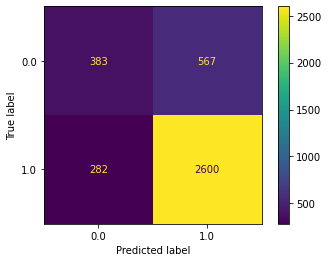

Runtime:  79  seconds


In [26]:
###TRANING XGBOOST
import xgboost as xgb

start = dt.now()

#Selecting and Preparing data
target = y_train_h
features = X_train_h
test_features = X_test_h

#Preloading model
xgb_h = xgb.XGBClassifier(seed=0,
                           random_state=0,
                           objective='binary:logistic',
                           n_estimators=760, #!
                           max_depth=2, #!
                           eta=0.85, #!
                           criterion='entropy',
                           subsample= 1.0, #!
                           class_weight= "balanced_subsample",
                           colsample_bylevel=0.75,#!
                           gamma=1.9000000000000001,#!
                           learning_rate=0.27,#!
                           )

#Robustness check with k-fold cross-validation
kfold = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
kfold_results = cross_val_score(xgb_h, features, target, cv=kfold, scoring="f1_weighted")

#Fitting the final model on joined training and validation data
xgb_h.fit(features, target)

#Predicting the train data
y_pred_tr = xgb_h.predict(features)

#Predicting the test data
y_pred_te = xgb_h.predict(test_features)

#Checking fscore
print("skfold validation f1-score mean: %.2f%% -||- sd: (%.2f%%)" % (kfold_results.mean()*100, kfold_results.std()*100))

print("train f1-score xgboost: ", f1_score(target, y_pred_tr, average='weighted'))

print("test f1-score xgboost: ", f1_score(y_test_h, y_pred_te, average='weighted'))

plot_confusion_matrix(xgb_h, test_features, y_test_h)
plt.show()

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

In [40]:
##Xgboost validation f1-score confidence interval

x = 0.7657
sd = 0.0067
TP = 2600
TN = 383
FP = 567
FN = 282

print("confidence interval  of cross-validation weighted f1-score: ", x," +/- ",1.959 * sd / np.sqrt(5))

print("accuracy: ", (TP+TN)/(TP+FP+FN+TN))
print("recall: ", TP/(TP+FN))
print("precision: ", TP/(TP+FP))

confidence interval  of cross-validation weighted f1-score:  0.7657  +/-  0.005869812605015598
accuracy:  0.7784446764091858
recall:  0.9021512838306731
precision:  0.8209662140827282


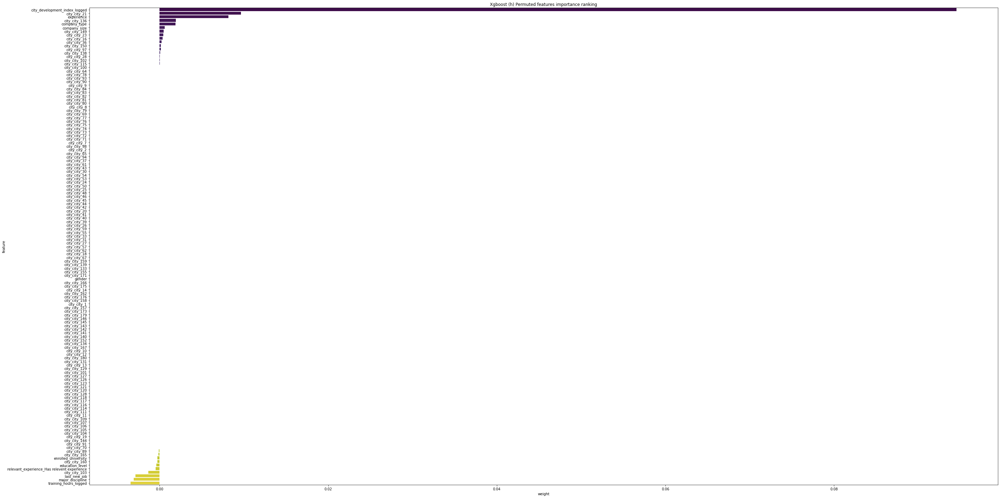

In [27]:
###Checking permuted feature ranking

permuted_feature_ranking(xgb_h, X_test_h, y_test_h, model_name="Xgboost (h)", standarscaler_object=None)

In [28]:
###Partial dependence profiles
#Source: https://ema.drwhy.ai/partialDependenceProfiles.html

h_xgb_exp = dx.Explainer(xgb_h, X_test_h, y_test_h, label = "HRA Xgboost Pipeline")

pd_xgb_n = h_xgb_exp.model_profile(variables=[x for x in list(X_test_h.columns)], N=25)

ld_xgb_n = h_xgb_exp.model_profile(type="conditional", N=25)
ld_xgb_n.result['_label_'] = 'LD profiles'
al_xgb_n = h_xgb_exp.model_profile(type="accumulated", N=25)
al_xgb_n.result['_label_'] = 'AL profiles'
pd_xgb_n.plot(al_xgb_n.plot(ld_xgb_n, variables=[x for x in list(X_test_h.columns)]))

Preparation of a new explainer is initiated

  -> data              : 3832 rows 133 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 3832 values
  -> model_class       : xgboost.sklearn.XGBClassifier (default)
  -> label             : HRA Xgboost Pipeline
  -> predict function  : <function yhat_proba_default at 0x7f2727031680> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.262, mean = 0.755, max = 0.973
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.956, mean = -0.00247, max = 0.738
  -> model_info        : package xgboost

A new explainer has been created!


Calculating accumulated dependency: 100%|██████████| 133/133 [00:05<00:00, 23.00it/s]


In [16]:
###Installing libraries

#Importing libraries and setting seed
np.random.seed(0)

In [ ]:
###TUNING TABNET
#Source of general work-flow: https://www.kaggle.com/code/neilgibbons/tuning-tabnet-with-optuna; https://github.com/dreamquark-ai/tabnet; https://optuna.readthedocs.io/en/stable/reference/generated/optuna.samplers.RandomSampler.html?highlight=random%20gridsearch; https://deepai.org/publication/tabnet-attentive-interpretable-tabular-learning
#Source fast training: https://github.com/dreamquark-ai/tabnet/issues/97
from pytorch_tabnet.tab_model import TabNetClassifier

start = dt.now()

TabNet_params = []

class F1_score(Metric):
    def __init__(self):
        self._name = "f1_score"
        self._maximize = True

    def __call__(self, y_true, y_score):
        y_score = np.where(y_score > 0.5, 1, 0)
        y_score = y_score[:,1]
        return f1_score(y_true, y_score, average="weighted")

def Objective(trial):
    mask_type = "entmax"
    n_d = trial.suggest_int("n_d", 32, 48, step=1) #!
    n_steps = trial.suggest_int("n_steps", 2, 3, step=1) #!
    gamma = trial.suggest_float("gamma", 1.0, 2.0, step=0.2) #!
    n_independent = trial.suggest_int("n_independent", 1, 4, step=1)
    n_shared = trial.suggest_int("n_shared", 1, 2, step=1)
    lambda_sparse = trial.suggest_float("lambda_sparse", 1e-6, 1e-2, log=True)
    optimizer_fn = trial.suggest_categorical("optimizer_fn", [torch.optim.Adadelta, torch.optim.Adagrad, torch.optim.Adam, torch.optim.Adamax, torch.optim.RMSprop, torch.optim.SGD])

    tabnet_params = dict(n_d=n_d, n_a=n_d, n_steps=n_steps, gamma=gamma, n_independent=n_independent,
                     lambda_sparse=lambda_sparse, optimizer_fn=optimizer_fn,
                     optimizer_params=dict(lr=2e-2, weight_decay=1e-5),#!
                     mask_type=mask_type, n_shared=n_shared,
                     scheduler_params=dict(mode="min", 
                                           patience = 5,
                                           min_lr=1e-5,#!
                                           factor=0.5),
                     scheduler_fn=torch.optim.lr_scheduler.ReduceLROnPlateau,
                     verbose=0,
                     seed=0,
                     )
    
    kf = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
    CV_score_array =[]
    X_train = X_train_h
    y_train = y_train_h

    for train_index, valid_index in kf.split(X_train.values, y_train.values):
        X_train_ix, X_valid_ix = X_train.values[train_index], X_train.values[valid_index]
        y_train_ix, y_valid_ix = y_train.values[train_index], y_train.values[valid_index]

        sc = StandardScaler()
        X_train_ix = sc.fit_transform(X_train_ix)
        X_valid_ix = sc.transform(X_valid_ix)

        classifier = TabNetClassifier(**tabnet_params)
        classifier.fit(X_train=X_train_ix, y_train=y_train_ix,
                  eval_set=[(X_train_ix, y_train_ix), (X_valid_ix, y_valid_ix)],
                  patience=10, max_epochs=50,
                  eval_metric=[F1_score], batch_size=32, virtual_batch_size=32)#!
        CV_score_array.append(classifier.best_cost)

    avg = np.mean(CV_score_array)
    return avg

study = optuna.create_study(direction="maximize", study_name='TabNet h table optimization')
study.optimize(Objective, n_trials=25)

tabnet_params_h = study.best_params
print("Best parameters: ", tabnet_params_h)

running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

# Best parameters:  {'n_d': 32, 'n_steps': 2, 'gamma': 1.2, 'n_independent': 3, 'n_shared': 1, 'lambda_sparse': 0.0002840374065648636, 'optimizer_fn': <class 'torch.optim.rmsprop.RMSprop'>}
# Runtime:  24958  seconds


Early stopping occurred at epoch 27 with best_epoch = 17 and best_val_1_f1_score = 0.77986
Best weights from best epoch are automatically used!

Early stopping occurred at epoch 15 with best_epoch = 5 and best_val_1_f1_score = 0.76569
Best weights from best epoch are automatically used!

Early stopping occurred at epoch 11 with best_epoch = 1 and best_val_1_f1_score = 0.77878
Best weights from best epoch are automatically used!

Early stopping occurred at epoch 19 with best_epoch = 9 and best_val_1_f1_score = 0.77738
Best weights from best epoch are automatically used!

Early stopping occurred at epoch 13 with best_epoch = 3 and best_val_1_f1_score = 0.78695
Best weights from best epoch are automatically used!

Early stopping occurred at epoch 10 with best_epoch = 0 and best_valid_f1_score = 0.78363
Best weights from best epoch are automatically used!


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:444: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  f"X has feature names, but {self.__class__.__name__} was fitted without"
/usr/local/lib/python3.7/dist-packages/sklearn/base.py:444: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  f"X has feature names, but {self.__class__.__name__} was fitted without"


skfold validation f1-score mean: 77.77% -||- sd: (0.69%)
train f1_score of tabnet:  0.7788721693627617
test f1_score of tabnet:  0.7738386126159118
Runtime:  879  seconds


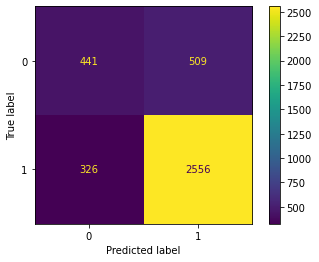

In [18]:
###TRAINING TABNET
#Source: https://github.com/dreamquark-ai/tabnet, https://www.stackvidhya.com/plot-confusion-matrix-in-python-and-why/
from pytorch_tabnet.tab_model import TabNetClassifier

start = dt.now()

class F1_score(Metric):
    def __init__(self):
        self._name = "f1_score"
        self._maximize = True

    def __call__(self, y_true, y_score):
        y_score = np.where(y_score > 0.5, 1, 0)
        y_score = y_score[:,1]
        return f1_score(y_true, y_score, average="weighted")

#Selecting and Preparing data
X_train = X_train_h
y_train = y_train_h

n_total_train = len(X_train)

train_indices, valid_indices = train_test_split(range(n_total_train), test_size=0.2, random_state=0)

#Preloading model
tb_h = TabNetClassifier(
    n_d=32,
    n_a=32,
    n_steps=2,
    gamma=1.2,
    n_independent=3,
    n_shared=1,
    lambda_sparse=0.0002840374065648636,
    optimizer_fn=torch.optim.RMSprop,
    optimizer_params=dict(lr=2e-2, weight_decay=1e-5),
    scheduler_params = dict(mode="min",
                            patience=5,
                            min_lr=1e-5,
                            factor=0.5),
    scheduler_fn=torch.optim.lr_scheduler.ReduceLROnPlateau,
    mask_type='entmax',
    seed=0,
    verbose=0
)

X_train_tb = X_train.values[train_indices] 
y_train_tb = y_train.values[train_indices]

X_valid_tb = X_train.values[valid_indices]
y_valid_tb = y_train.values[valid_indices]

sc_3 = StandardScaler()
X_train_tb = sc_3.fit_transform(X_train_tb)
X_valid_tb = sc_3.transform(X_valid_tb)

#Robustness check with k-fold cross-validation#!

kf = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
CV_score_array =[]

for train_index, valid_index in kf.split(X_train.values, y_train.values):
    X_train_ix, X_valid_ix = X_train.values[train_index], X_train.values[valid_index]
    y_train_ix, y_valid_ix = y_train.values[train_index], y_train.values[valid_index]

    sc = StandardScaler()
    X_train_ix = sc.fit_transform(X_train_ix)
    X_valid_ix = sc.transform(X_valid_ix)

    tb_h.fit(X_train=X_train_ix, y_train=y_train_ix,
              eval_set=[(X_train_ix, y_train_ix), (X_valid_ix, y_valid_ix)],
              patience=10, max_epochs=50,
              eval_metric=[F1_score], batch_size=32, virtual_batch_size=32)
    CV_score_array.append(tb_h.best_cost)

avg = np.mean(CV_score_array)
sd = np.std(CV_score_array)

#Fitting the final model on joined training and validation data

max_epochs = 50

tb_h.fit(
    X_train=X_train_tb, y_train=y_train_tb,
    eval_set=[(X_train_tb, y_train_tb), (X_valid_tb, y_valid_tb)],
    eval_name=['train', 'valid'],
    eval_metric=[F1_score],
    max_epochs=max_epochs,
    patience=10,
    batch_size=32, virtual_batch_size=32
)

preds_mapper = { idx : class_name for idx, class_name in enumerate(tb_h.classes_)}

#Predicting the train data
preds_h_tr = tb_h.predict(sc_3.transform(X_train_h))

#Predicting the test data
preds_h_te = tb_h.predict(sc_3.transform(X_test_h))

print("skfold validation f1-score mean: %.2f%% -||- sd: (%.2f%%)" % (avg*100, sd*100))#!

print("train f1_score of tabnet: ",f1_score(y_pred=preds_h_tr, y_true=y_train_h, average='weighted'))

print("test f1_score of tabnet: ",f1_score(y_pred=preds_h_te, y_true=y_test_h, average='weighted'))

cf_matrix = confusion_matrix(y_test_h, preds_h_te)
disp = ConfusionMatrixDisplay(confusion_matrix=cf_matrix)
disp.plot()


running_secs = (dt.now() - start).seconds
print("Runtime: ", running_secs, " seconds")

In [21]:
##TABNET validation f1-score confidence interval

x = 0.7777
sd = 0.0069
TP = 2556
TN = 441
FP = 509
FN = 326

print("confidence interval of cross-validation weighted f1-score: ", x," +/- ",1.959 * sd / np.sqrt(5))

print("accuracy: ", (TP+TN)/(TP+FP+FN+TN))
print("recall: ", TP/(TP+FN))
print("precision: ", TP/(TP+FP))

confidence interval of cross-validation weighted f1-score:  0.7777  +/-  0.006045030891732481
accuracy:  0.782098121085595
recall:  0.8868841082581541
precision:  0.833931484502447


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:444: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  f"X has feature names, but {self.__class__.__name__} was fitted without"


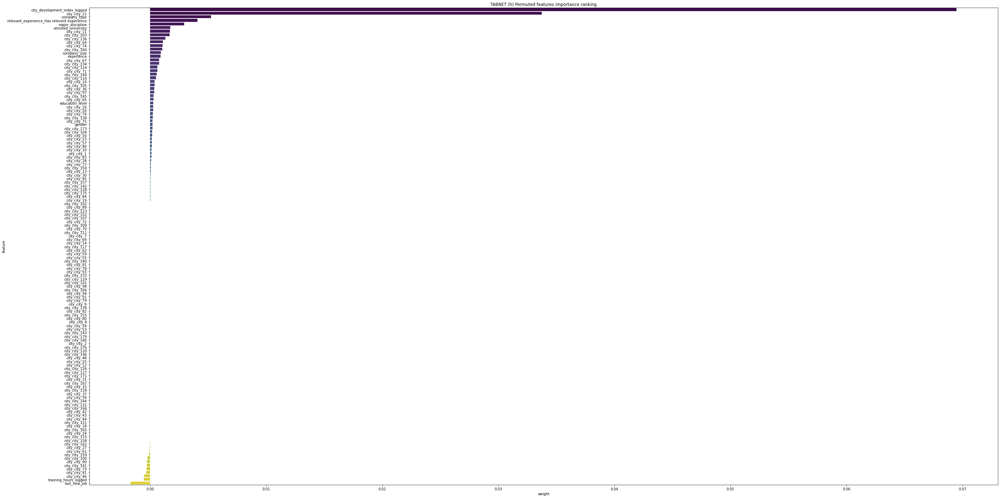

In [19]:
###Checking permuted feature ranking

permuted_feature_ranking(tb_h, X_test_h, y_test_h, model_name="TABNET (h)", standarscaler_object=sc_3)

In [20]:
###Generate Feature importance heatmap
#Source: https://www.kaggle.com/code/mmkuznecov/tabnet-catboost-flaml

#Extract the explainability variables
explainability_matrix , masks = tb_h.explain(sc_3.transform(X_test_h))

# Normalize the importance by sample
normalized_explain_mat = np.divide(explainability_matrix, explainability_matrix.sum(axis=1).reshape(-1, 1)+1e-8)

# Add prediction to better understand correlation between features and predictions
val_preds = tb_h.predict(sc_3.transform(X_test_h))

explain_and_preds = np.hstack([normalized_explain_mat, val_preds.reshape(-1, 1)])

features = [i for i in list(X_test_h.columns)]

px.imshow(explain_and_preds[:,:],
          labels=dict(x="Features", y="Samples", color="Importance"),
          x=features+["prediction"],
          title="Sample wise feature importance",
          color_continuous_scale='viridis',
          height=1000)

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:444: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  f"X has feature names, but {self.__class__.__name__} was fitted without"
/usr/local/lib/python3.7/dist-packages/sklearn/base.py:444: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  f"X has feature names, but {self.__class__.__name__} was fitted without"
